## Data

Youtube video: https://www.youtube.com/watch?v=ulxDhZIaSCU

Download the above video as the source of your data.

## Approach

Below is my approach for this problem 

1. Download the youtube video. 
2. Extract frames per second
3. Extract Faces from frame using MTCNN 
4. For each face , generate embedding using Facenet512
5. Do clustering using HDBSCAN

#### Setup


- Create virtual env (Python 3.9)

```
conda create -n py39 python=3.9
```

- Install dependencies

```
pip install -r requirements.txt
```

- Install youtube-dl package (This is needed to download Age restricted youtube videos without logging in)

```
brew install youtube-dl
```


### Step 1:  Download Youtube video

- We can use `pytube` to download the youtube videos. 
- When `pytube` throws errors due to `AgeRestrictedError`, we use `youtube-dl` to download the videos.

In [1]:
from pytube import YouTube
from pytube.exceptions import AgeRestrictedError
import subprocess


class YoutubeVideoDownloader:
    """Download Youtube video from url"""
    def __init__(self, url:str , resolution: int ) -> None:
        self.url = url
        self.resolution = self._check_is_valid_resolution(resolution)

    def _check_is_valid_resolution(self,resolution):
        VALID_RESOLUTIONS = [320,720]
        if resolution not in VALID_RESOLUTIONS:
            raise ValueError(f"resolution should be one of {VALID_RESOLUTIONS}")

    @staticmethod
    def _generate_command(url: str):
        return f"youtube-dl {url} -f best"
    
    def download_video(self):
        try:
            yt = YouTube(self.url)
            filtered_streams = yt.streams.filter(res=f"{self.resolution}p", progressive=True)
            stream = filtered_streams.first()
            stream.download()
            
        except AgeRestrictedError as e:
            command = self._generate_command(self.url)
            subprocess.run(command, shell=True)


In [3]:
yt = YoutubeVideoDownloader(url="https://www.youtube.com/watch?v=ulxDhZIaSCU",
                            resolution=720)
yt.download_video()

[youtube] ulxDhZIaSCU: Downloading webpage


[download] Destination: The Office Funniest Moments I Quote Everyday - The Office US-ulxDhZIaSCU.mp4
[download] 100% of 43.29MiB in 11:4859KiB/s ETA 00:00known ETA


### Step 2: Extract Frames from Video

- Extract frames from video using `CV2`
- To avoid repetition, sample frames based on a frequency (default = 1s)

In [8]:
import cv2
import os 
from pathlib import Path


class FrameExtractor:
    """Extract Frames based on a sampling frequency from video"""
    def __init__(self,vid_path : Path , 
                 output_dir : Path, 
                 sampling_frequency : int = 1) -> None:
        self.vid_path = vid_path
        self.output_dir = output_dir
        self.sampling_frequency = sampling_frequency


    def extract_frames(self):
        os.makedirs(self.output_dir, exist_ok=True)
        video = cv2.VideoCapture(self.vid_path)
        fps = video.get(cv2.CAP_PROP_FPS)
        frame_count = 0
        target_frame_index = 0
        while video.isOpened():
            ret, frame = video.read()
            if not ret:
                break
            if frame_count == target_frame_index:
                output_path = os.path.join(self.output_dir, f"frame_{frame_count}.jpg")
                cv2.imwrite(output_path, frame)
                target_frame_index += int(fps * self.sampling_frequency)
            frame_count += 1
        video.release()
        cv2.destroyAllWindows()
        

In [6]:
FRAMES_OUT_DIR = "/Users/whiletruelearn/projects/video-analytics/frames"
VIDEO_PATH = "/Users/whiletruelearn/projects/video-analytics/The Office Funniest Moments I Quote Everyday - The Office US-ulxDhZIaSCU.mp4"

fr_extractor = FrameExtractor(vid_path=VIDEO_PATH,
                              output_dir=FRAMES_OUT_DIR)
fr_extractor.extract_frames()

### Step 3: Extract Faces and the bounding box information



- I used `deepface` library to extract the faces from frames. 
- Tried a bunch of algorithms such as MTCNN , retinafaces , yolov8 small for face extraction.
- Found `MTCNN` to be suitable and give decent extraction of faces based on visual inspection.

- Some of the images extracted was blurry and I wanted to remove them. Used techniques spceified [here](https://pyimagesearch.com/2015/09/07/blur-detection-with-opencv/) to remove those. 

- Bounding  box information as well as faces are written to the `faces` directory

In [15]:
from deepface import DeepFace
from pathlib import Path
from docarray import DocumentArray
from PIL import Image
from dataclasses import dataclass
import numpy as np 
import cv2
import uuid 
import glob
import json 


@dataclass
class BoundingBox:
    image_path : Path
    left: float
    top: float
    right: float
    bottom: float


class FaceExtractor:

    """ Extract Faces from images with their bounding box information"""
    def __init__(self,images_directory : Path,
                 output_directory : Path,
                 confidence_threshold : float = 0.999, 
                 lap_var_threshold : int = 11 ,
                 algorithm : str = "mtcnn",
                 crop_size : tuple = (256,256)):
        
        self.images_dir = images_directory
        self.out_dir = output_directory
        self.conf_thrshld = confidence_threshold
        self.lap_var_thrshld = lap_var_threshold 
        self.algorithm = algorithm
        self.crop_size = crop_size
        self.frame_stats = {}
        
    def _get_image_paths(self):
        return glob.glob(f"{self.images_dir}/*.jpg")
    
    
    def _is_blur_image(self, cropped_image):

        gray = cv2.cvtColor(np.asarray(cropped_image), cv2.COLOR_BGR2GRAY)
        lap_var = cv2.Laplacian(gray, cv2.CV_64F).var()
        return True if lap_var < self.lap_var_thrshld else False 
    
    @staticmethod
    def _get_bbox(cords,image_path):
        bbox = BoundingBox(image_path= image_path,
                           left = cords["x"],
                           top=cords["y"],
                           right=cords["x"] + cords["w"],
                           bottom=cords["y"] + cords["h"])
        
        return bbox

    def _extract_face(self, image_path : Path):
        try:
            faces = DeepFace.extract_faces(image_path,detector_backend=self.algorithm)
            self.frame_stats[image_path] = len(faces)
            for face in faces:
                face_coords = face["facial_area"]
                confidence = face["confidence"]
                if confidence >= self.conf_thrshld:
                    image = Image.open(image_path)
                    bbox = self._get_bbox(face_coords,image_path)
                    cords = [bbox.left,
                                bbox.top,
                                bbox.right, 
                                bbox.bottom]
                    cropped_image = image.crop(cords)
                    cropped_image = cropped_image.resize(self.crop_size)
                    if not self._is_blur_image(cropped_image):
                        uid = uuid.uuid1().hex[:6]
                        cropped_image.save(f"{self.out_dir}/face_{uid}.jpg")
                        with open(f"{self.out_dir}/face_{uid}.json",'w') as f:
                            f.write(json.dumps(bbox.__dict__))
            return True
        except Exception:
            print(f"Error in processing {image_path}")
            return False

    def extract_faces(self):
        os.makedirs(self.out_dir,exist_ok=True)
        image_paths = self._get_image_paths()
        extract_status = [self._extract_face(image_path) for image_path in image_paths]
        success = sum(extract_status)
        failure = len(image_paths) - success
        print(f"Succeeded: {success} ; Failure: {failure}")

    def display_faces(self):
        img_arr = DocumentArray.from_files(f"{self.out_dir}/*.jpg")
        img_arr.plot_image_sprites()

In [16]:
IMAGES_DIR = "/Users/whiletruelearn/projects/video-analytics/frames"
FACES_OUT_DIR = "/Users/whiletruelearn/projects/video-analytics/faces"

face_extractor = FaceExtractor(images_directory=IMAGES_DIR,
                               output_directory=FACES_OUT_DIR,
                               confidence_threshold=0.95,
                               lap_var_threshold=10)
face_extractor.extract_faces()

1/1 [==============================] - 0s 10ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_10511.jpg
3/3 [==============================] - 0s 2ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_16606.jpg
3/3 [==============================] - 0s 3ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_16376.jpg
1/1 [==============================] - 0s 13ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_1679.jpg
1/1 [==============================] - 0s 16ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_15640.jpg
3/3 [==============================] - 0s 3ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_16629.jpg
1/1 [==============================] - 0s 10ms/step
Error in processing /Users/whiletruelearn/projects/video-analytics/frames/frame_5750.jpg
1/1 [======

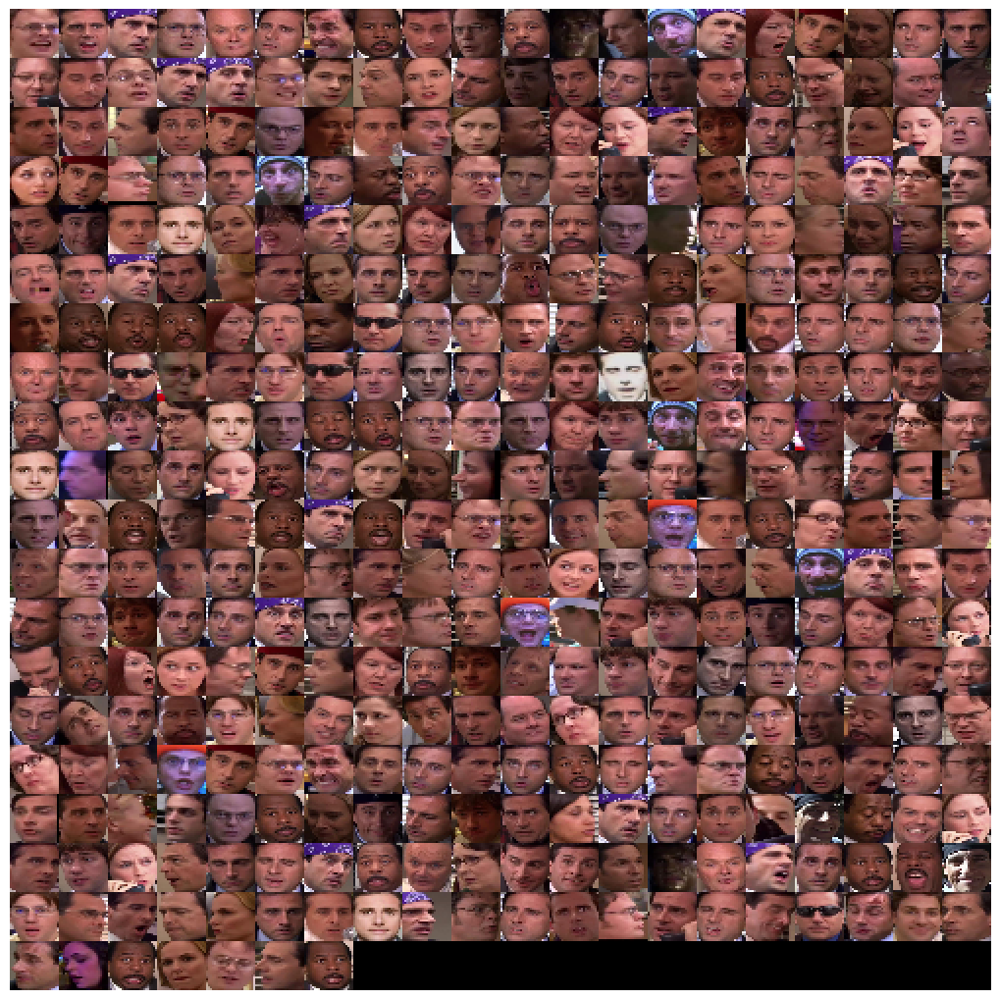

In [17]:
face_extractor.display_faces()

### Step 4 & 5: Get Embedding for each face and do clustering

- For generating embeddings, tried a bunch of approaches such as VGG, VGG-Face, Facenet, Facenet512
- Found the clustering quality to be better for `Facenet512`

- For clustering, tried out DBSCAN, HDBSCAN, Gaussian Mixture, Affinity Propagation. 
- Specifically went for clustering methods where we need not specify `number of clusters` ahead of time. 

- Gaussian mixture also was doing well, but finding the right hyper parameter was taking a bit of time. So decided to skip it. 
- HDBSCAN gave the most accurate results on visual inspection. 

- Good thing with HDBSCAN and DBSCAN methods is that they are tolerant with outliers and give a cluster label `-1` which is the outlier class. 
- HDBSCAN also runs pretty fast which is useful for quick iteration. 
- HDBSCAN also makes it easy to find the medoid that was used for each cluster, this was a core ask in the problem statement.


In [23]:
from pathlib import Path
from sklearn.cluster import HDBSCAN 
from docarray import DocumentArray
from sklearn.metrics import silhouette_score, calinski_harabasz_score

import pandas as pd
import hashlib
import shutil 
import os

class Clustering:
    def __init__(self,faces_directory: Path,
                 cluster_output_dir : Path,
                 embedding_model : str = "Facenet512") -> None:
        self.faces_dir = faces_directory
        self.cluster_out_dir = cluster_output_dir
        self.embedding_model = embedding_model 
        self.vec_to_image_path = {}
        self.mediods = None
        self.cluster_ids = None
        self.metrics = {}
        self.cluster_stats = None

    def _get_embeddings(self, image_path):
        vec =  DeepFace.represent(image_path,
                                  enforce_detection=False,
                                  model_name=self.embedding_model)[0]["embedding"]
        vec_hash = self._get_vector_hash(vec)
        self.vec_to_image_path[vec_hash] = image_path
        return vec 

    def _get_vector_hash(self,vec):
       
        vector_str = str(vec)
        hash_object = hashlib.sha256()
        hash_object.update(vector_str.encode('utf-8'))
        hash_value = hash_object.hexdigest()
        return hash_value
    

    def _get_faces(self):
        faces_arr = DocumentArray.from_files(f"{self.faces_dir}/*.jpg")
        return faces_arr
    
    def _calculate_metrics(self,X,labels):
        self.metrics["silhouette_avg"] = silhouette_score(X, labels)
        self.metrics["calinski_harabasz_score"] = calinski_harabasz_score(X, labels)
      
    def cluster_faces(self):

        os.makedirs(self.cluster_out_dir,exist_ok=True)
        faces_arr = self._get_faces()
        embeddings = []
        face_paths = []
        

        for face in faces_arr:
            face_paths.append(face.uri)
            embeddings.append(self._get_embeddings(face.uri))

        df = pd.DataFrame(embeddings)
        X = df.values
        target = pd.DataFrame(face_paths,columns=["image_paths"])

        hdbscan = HDBSCAN(store_centers="medoid")
        clusters = hdbscan.fit_predict(X)
        target["cluster_ids"] = clusters
        
        self._calculate_metrics(X,clusters)
        self.mediods = hdbscan.medoids_
        self.cluster_ids = np.unique(clusters)


        
        target_grp = target.groupby("cluster_ids")
        self.cluster_stats = target_grp.size().sort_values(ascending=False)
        print(f"Cluster representation \n {self.cluster_stats}")

        for cluster_id in self.cluster_ids:
            target_group = target_grp.get_group(cluster_id)
            dir_path = f"{self.cluster_out_dir}/cluster_{cluster_id}"
            os.makedirs(dir_path,exist_ok=True)
            img_paths = target_group["image_paths"].unique().tolist()
            for img_pth in img_paths:
                filename = img_pth.split("/")[-1]
                shutil.copy(f"{img_pth}",f"{dir_path}/{filename}")

    def find_medoid_image(self):
        cluster_ids = self.cluster_ids
        # Remove cluster id -1, medoid is not stored for outlier class
        cluster_ids = np.delete(cluster_ids,0)
        for medoid,cluster_id in zip(self.mediods,cluster_ids):
            vec_hash = self._get_vector_hash(medoid.tolist())
            image_path = self.vec_to_image_path[vec_hash]
            print(f"Medoid for cluster {cluster_id}")
            darr = DocumentArray.from_files(image_path)
            darr.plot_image_sprites()


    def visualize_clusters(self):

        for cluster_id in self.cluster_ids:
            if cluster_id >= 0:
                image_wildcard = f"{self.cluster_out_dir}/cluster_{cluster_id}/*.jpg"
                d_arr = DocumentArray.from_files(image_wildcard)
                print(f"####### Cluster {cluster_id} ##########")
                d_arr.plot_image_sprites()


In [24]:
FACES_DIR = "/Users/whiletruelearn/projects/video-analytics/faces"
CLUSTERING_OUT_DIR = "/Users/whiletruelearn/projects/video-analytics/clusters"

clstr = Clustering(faces_directory=FACES_DIR,
                   cluster_output_dir=CLUSTERING_OUT_DIR)

clstr.cluster_faces()

Cluster representation 
 cluster_ids
 9     151
-1      75
 11     35
 12     27
 4      15
 6      15
 13     13
 5      10
 2       9
 7       8
 3       7
 8       7
 0       5
 1       5
 10      5
dtype: int64


####### Cluster 0 ##########


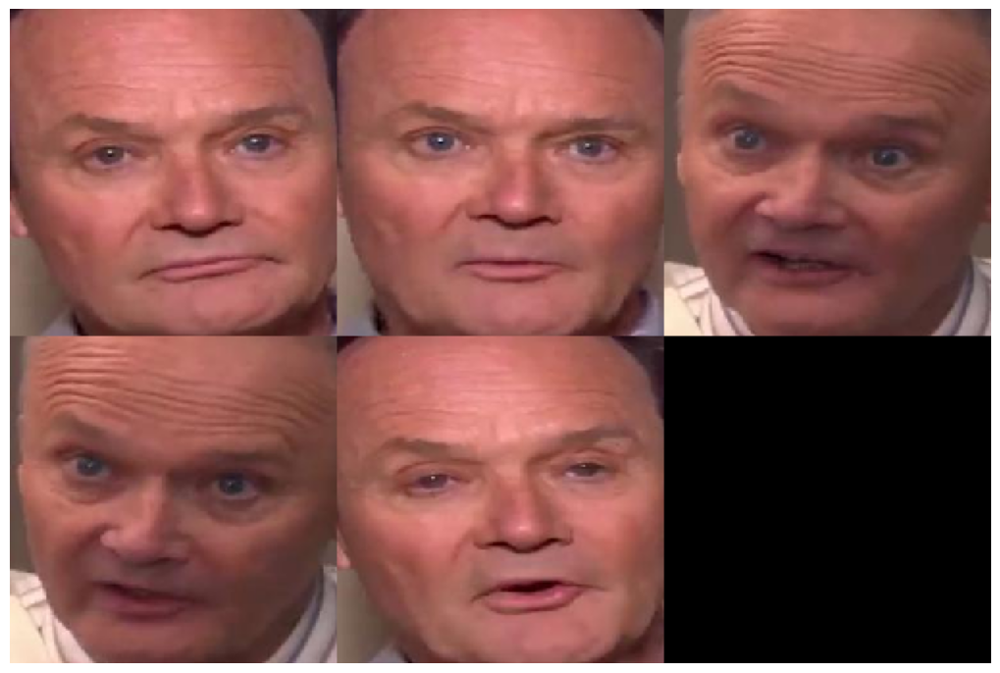

####### Cluster 1 ##########


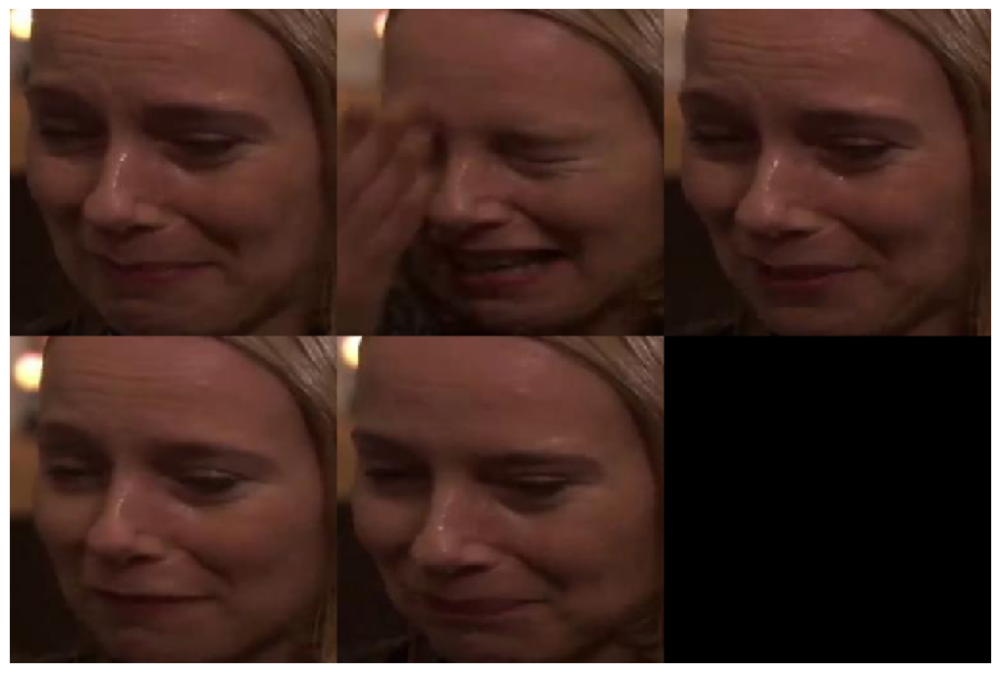

####### Cluster 2 ##########


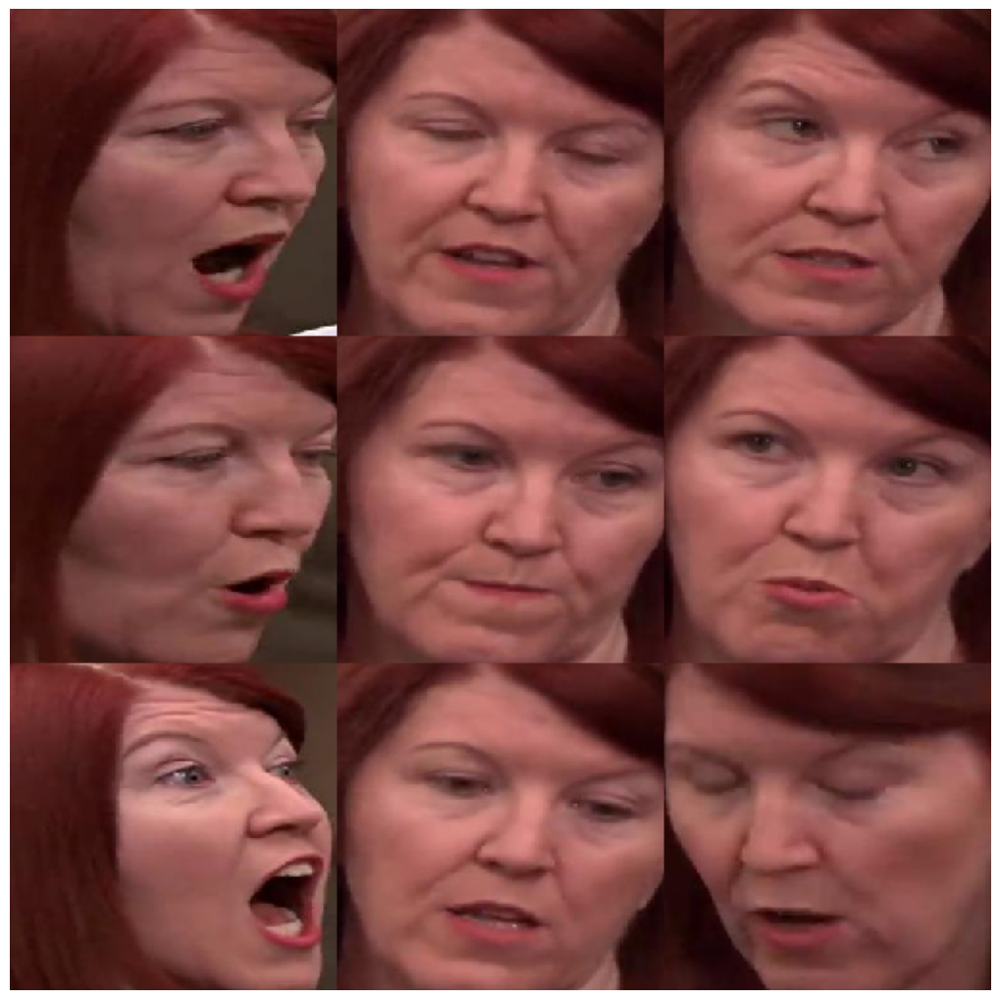

####### Cluster 3 ##########


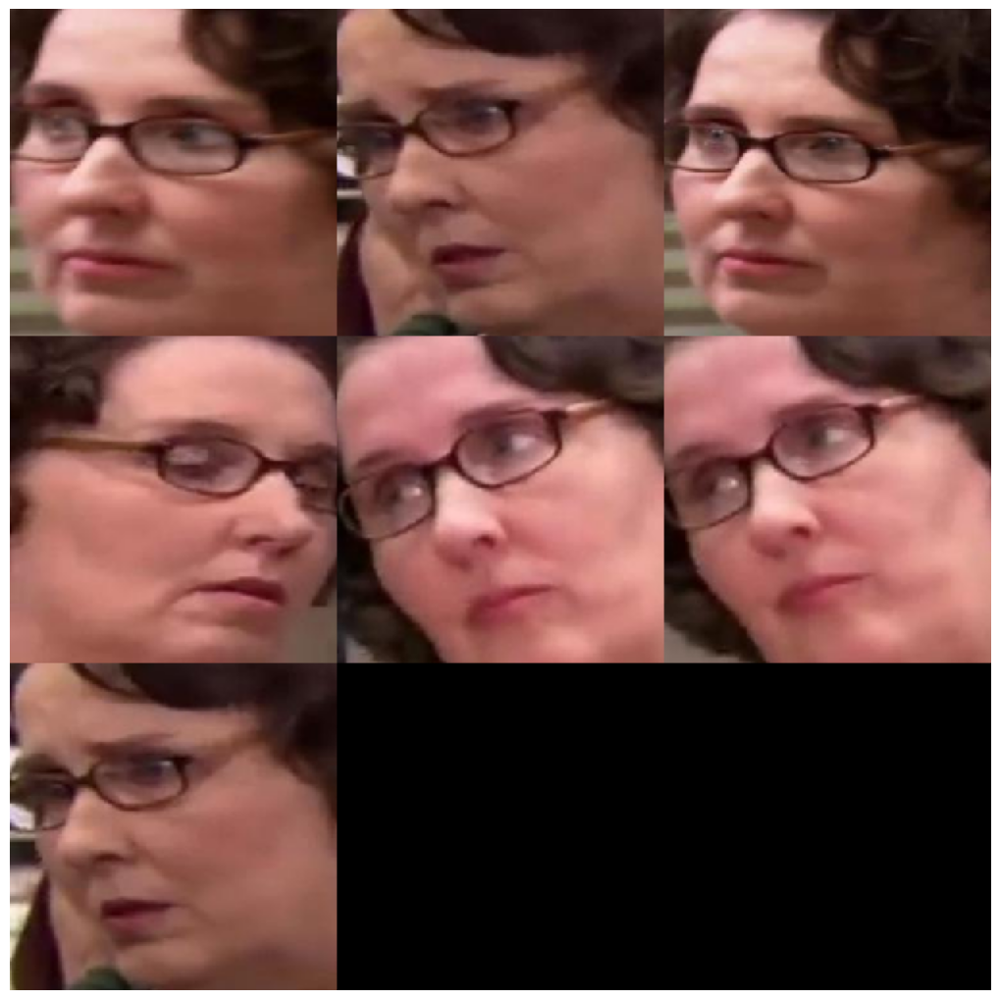

####### Cluster 4 ##########


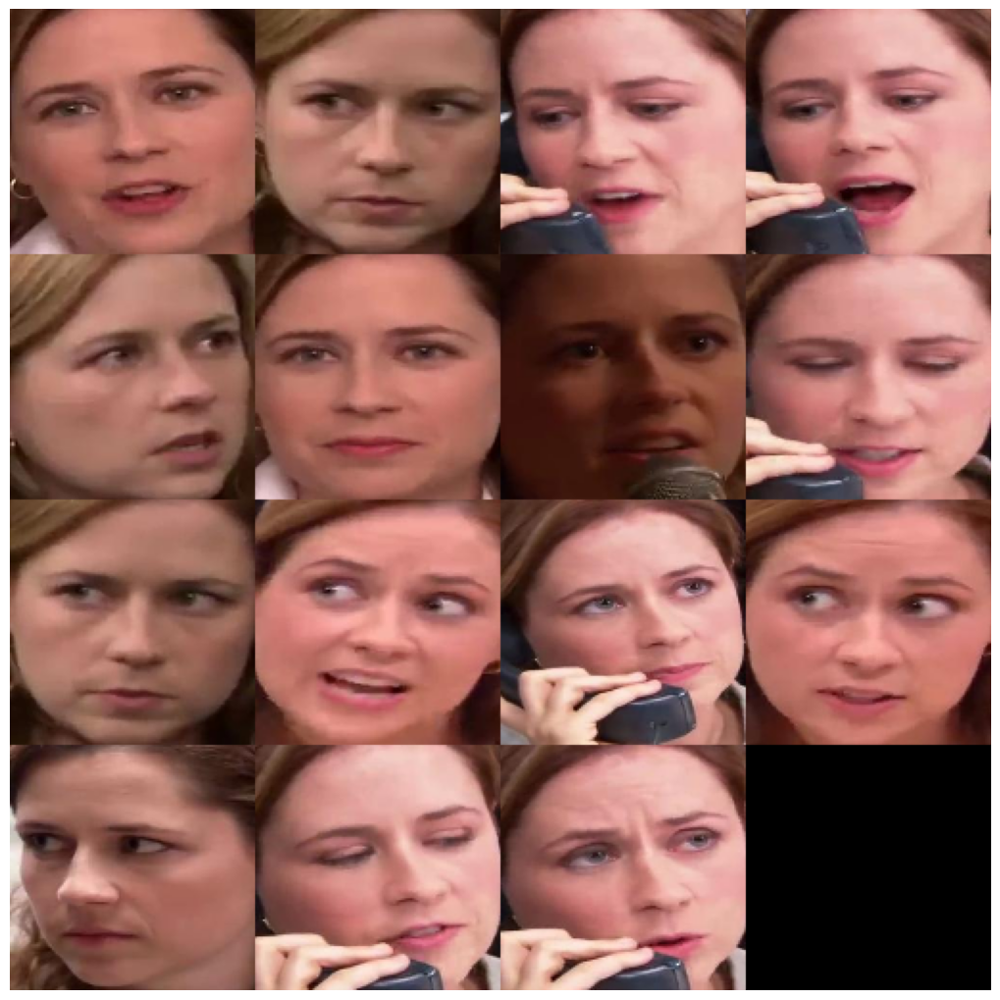

####### Cluster 5 ##########


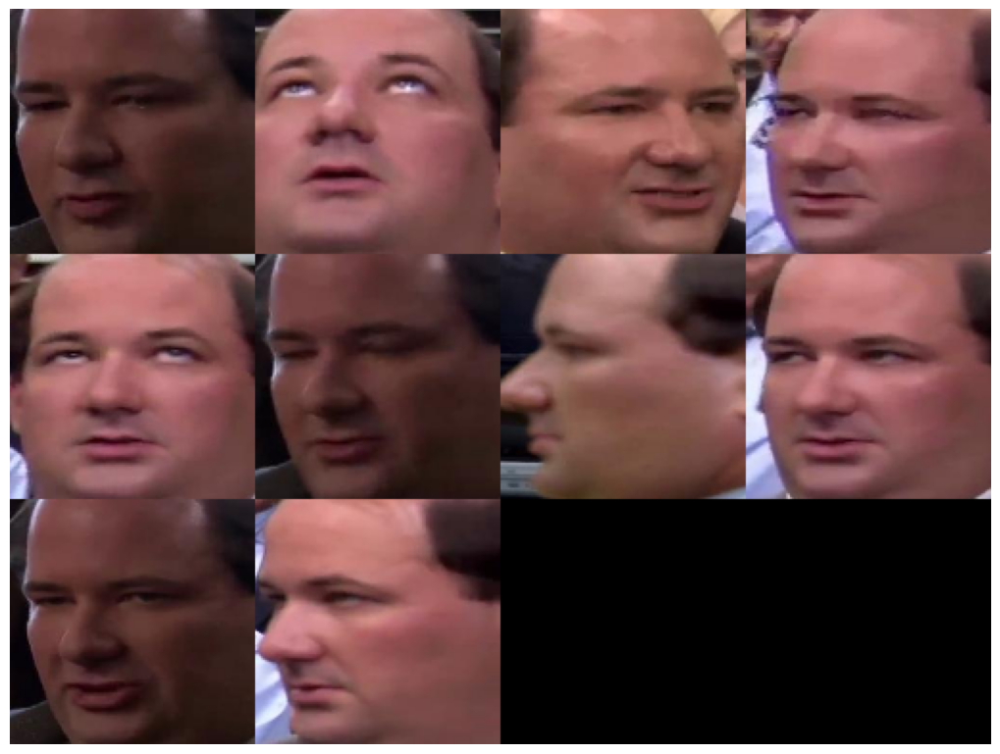

####### Cluster 6 ##########


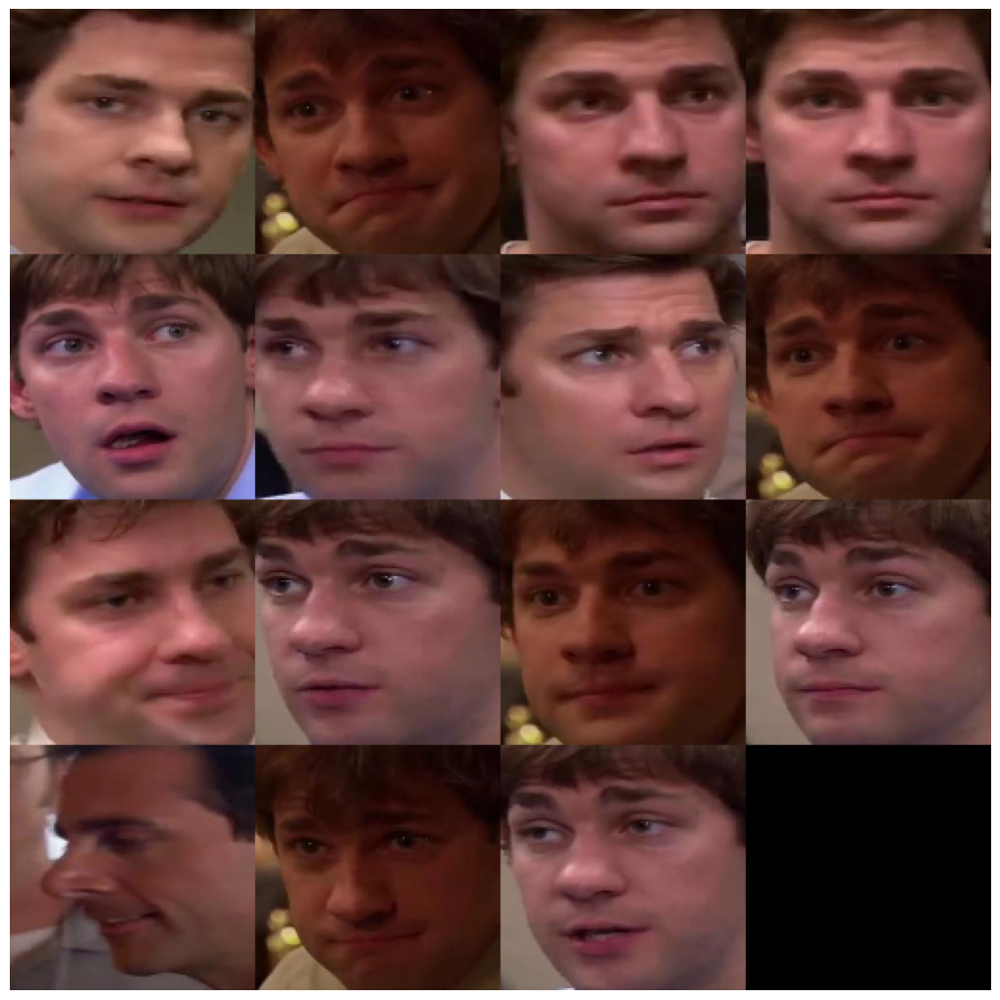

####### Cluster 7 ##########


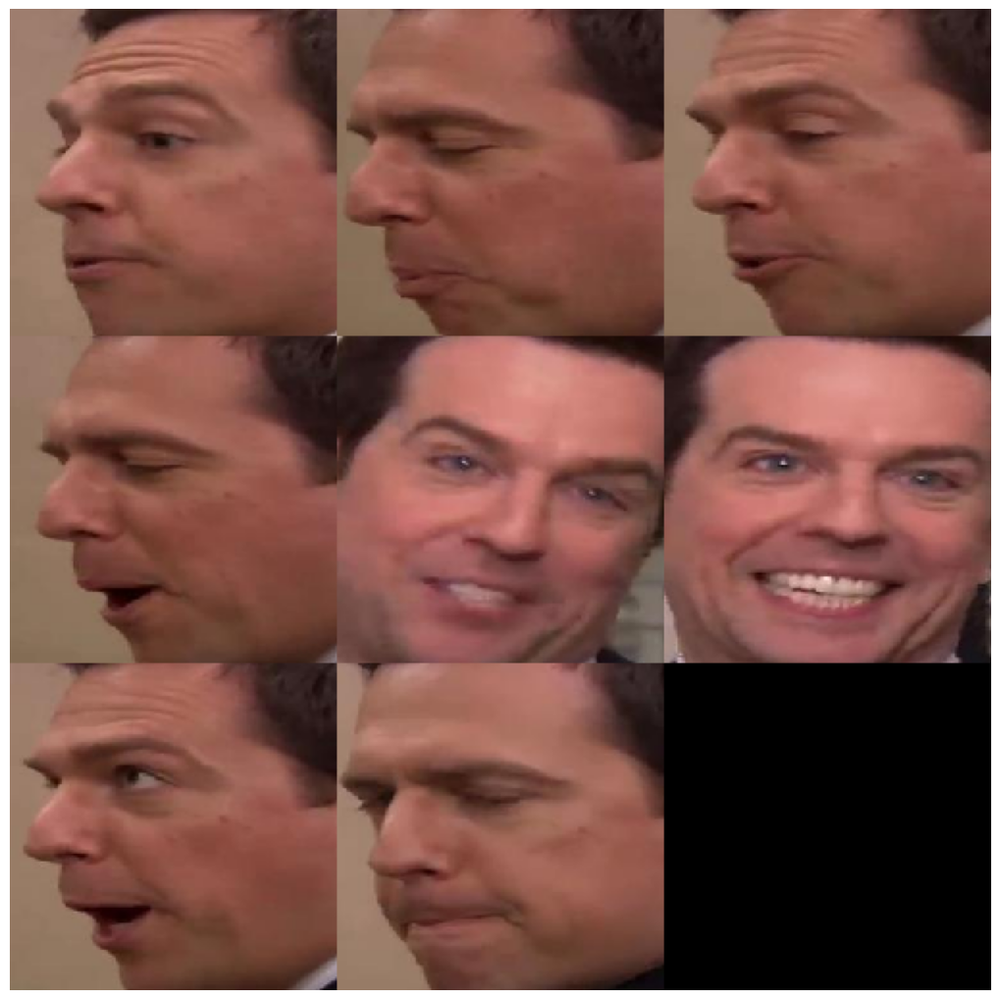

####### Cluster 8 ##########


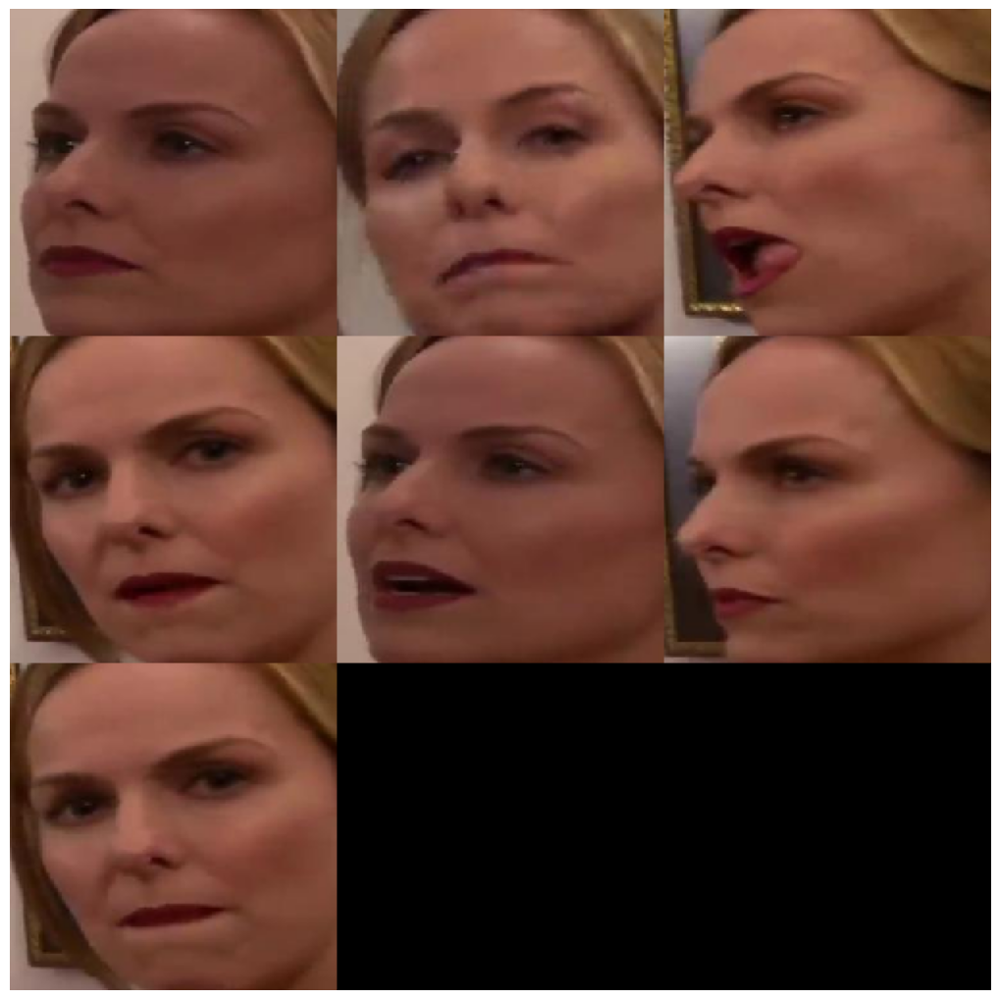

####### Cluster 9 ##########


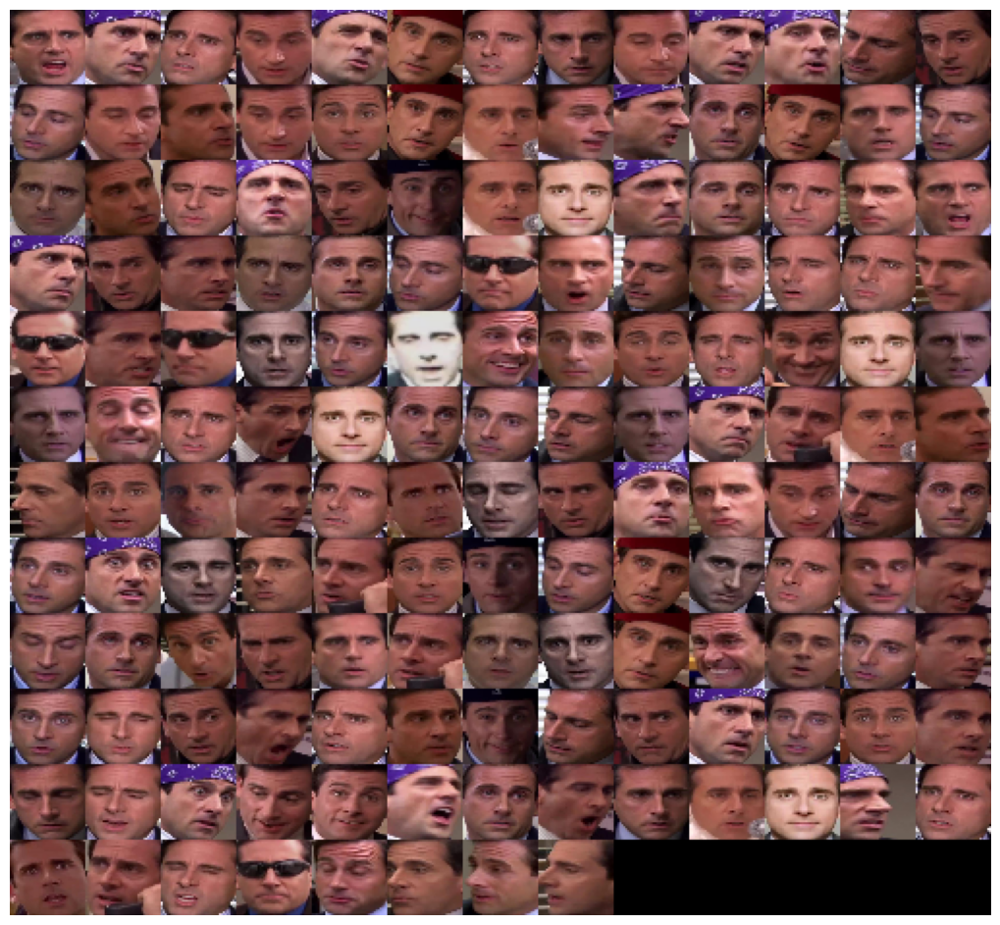

####### Cluster 10 ##########


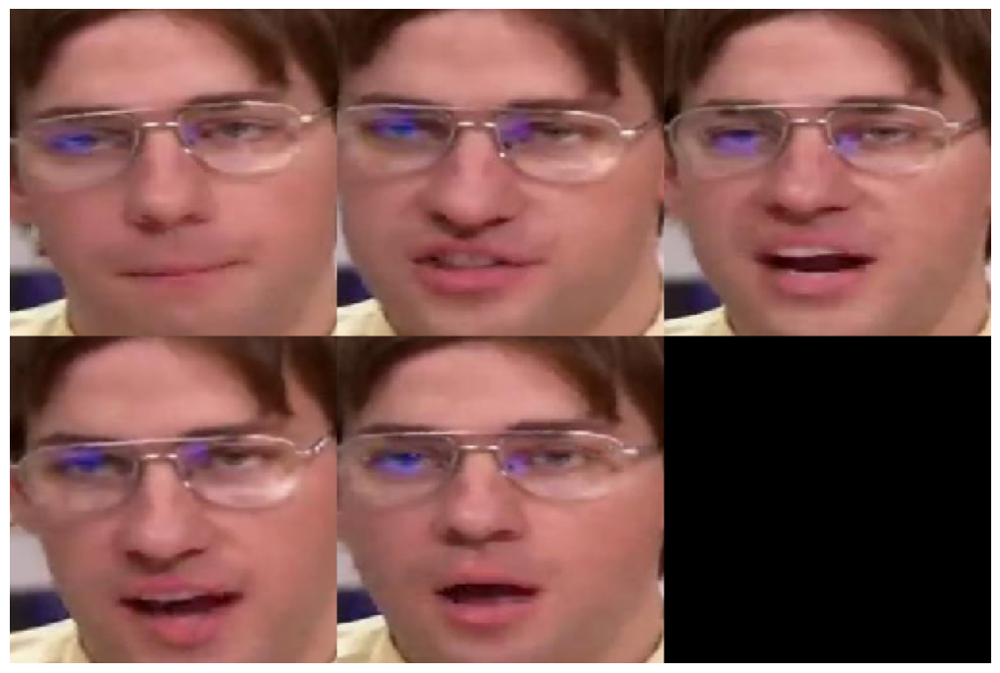

####### Cluster 11 ##########


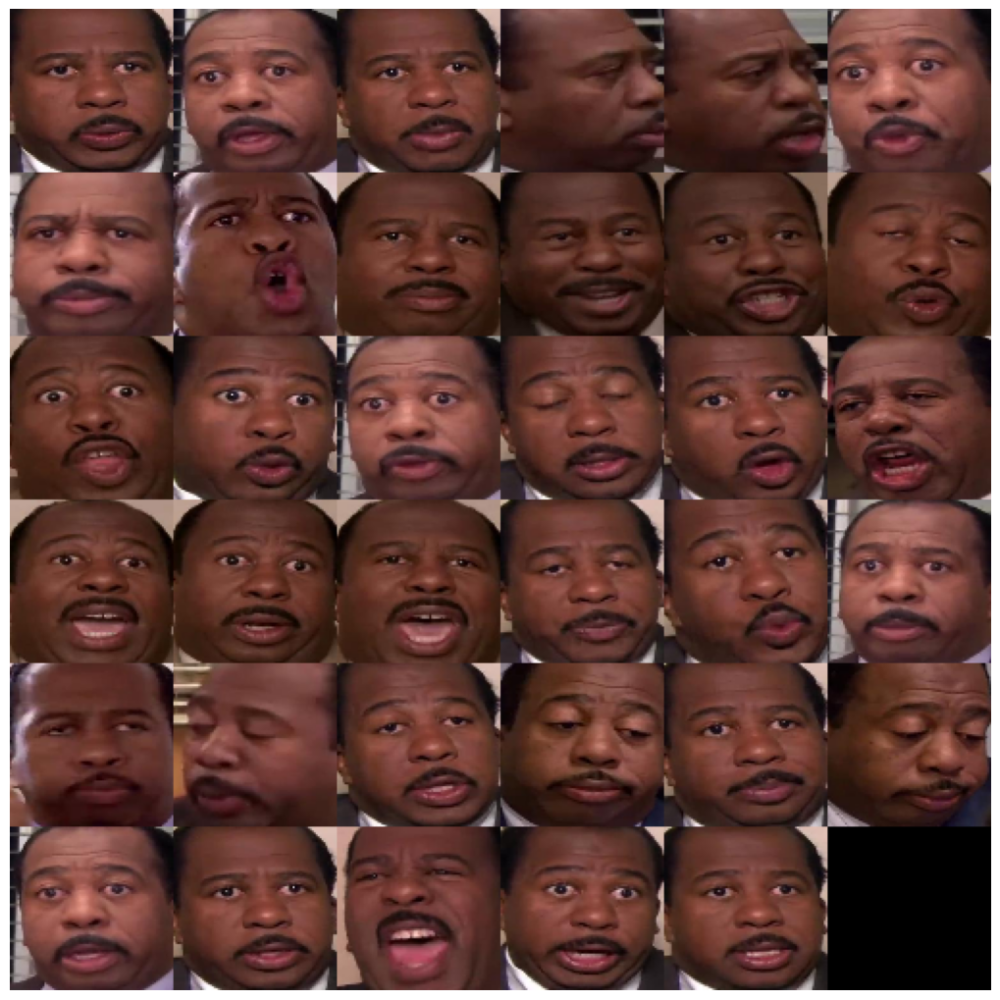

####### Cluster 12 ##########


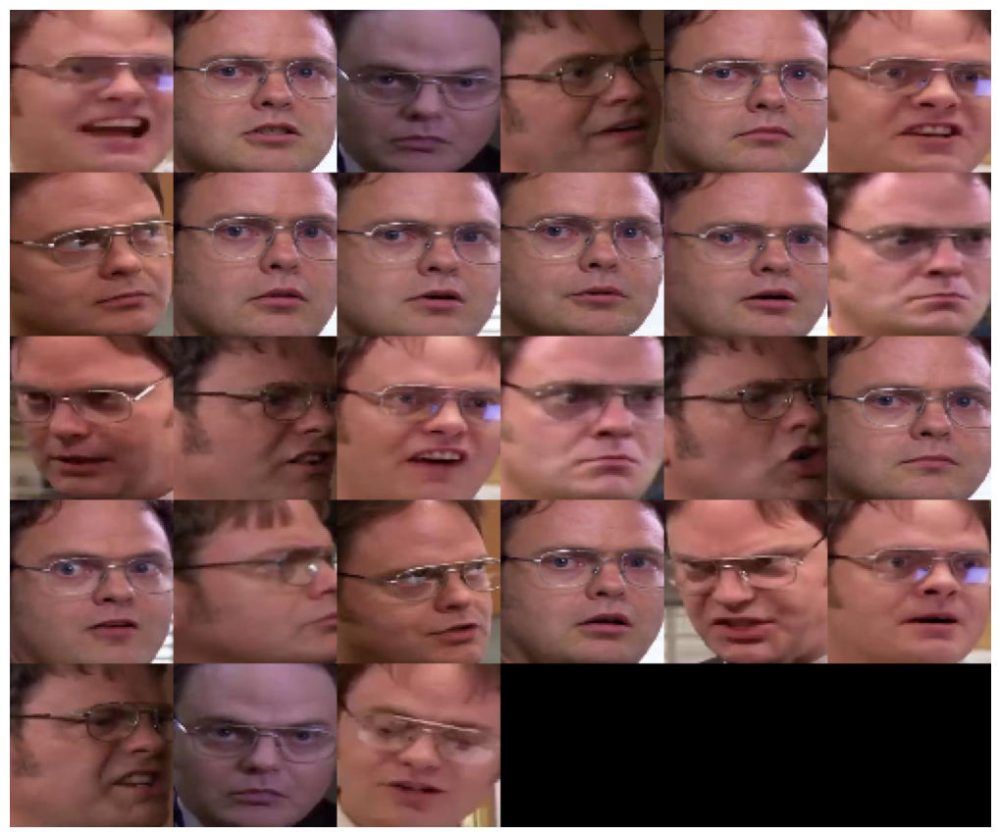

####### Cluster 13 ##########


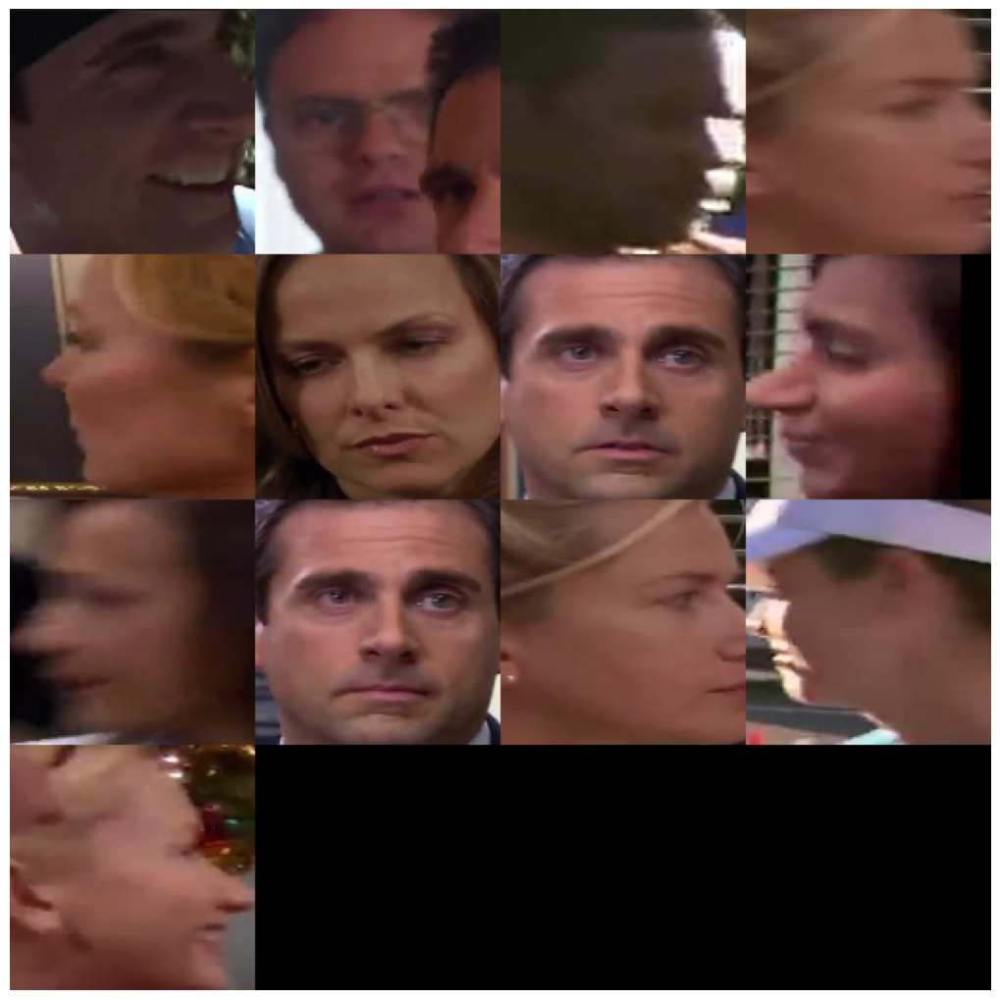

In [25]:
clstr.visualize_clusters()

In [26]:
clstr.metrics

{'silhouette_avg': 0.17729037564897343,
 'calinski_harabasz_score': 24.241735226103522}

In [27]:
clstr.cluster_stats

cluster_ids
 9     151
-1      75
 11     35
 12     27
 4      15
 6      15
 13     13
 5      10
 2       9
 7       8
 3       7
 8       7
 0       5
 1       5
 10      5
dtype: int64

-  cluster `13` seems to be erroneous
- we save the `medoids` and `cluster ids` for use in web service

Medoid for cluster 0


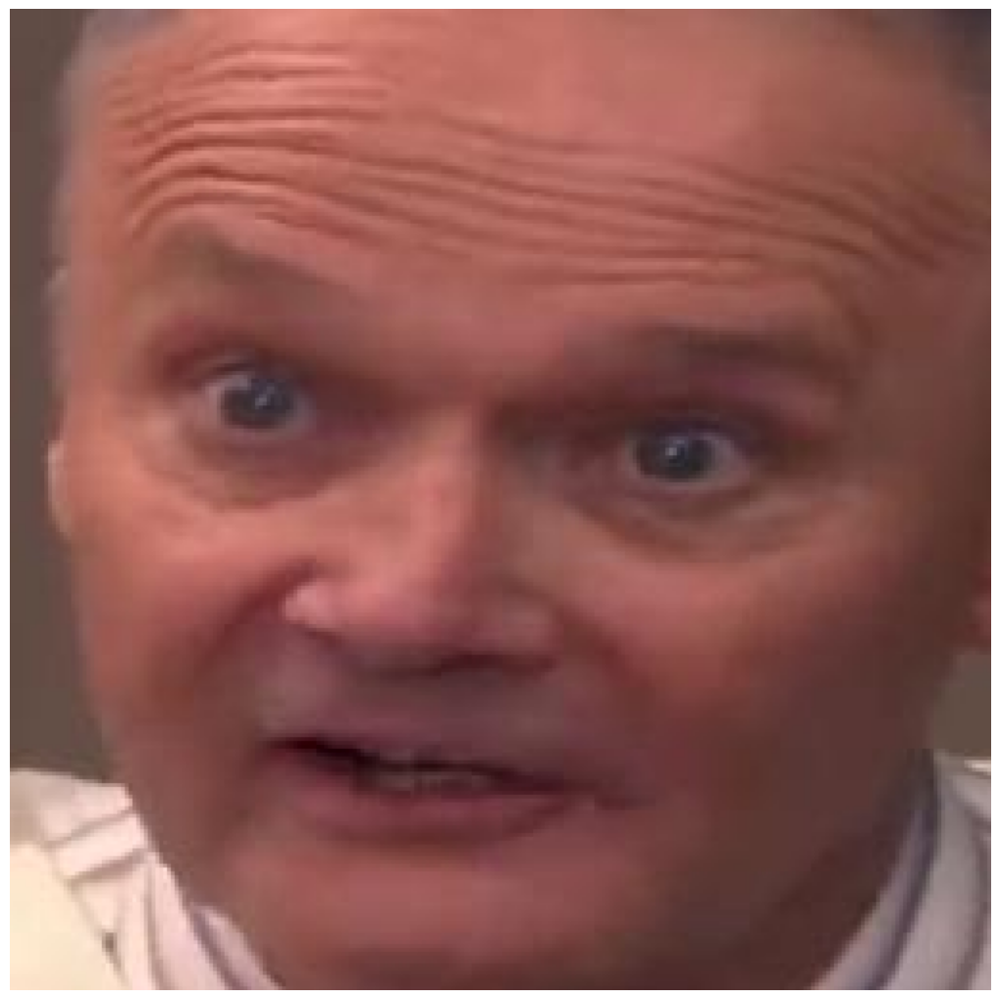

Medoid for cluster 1


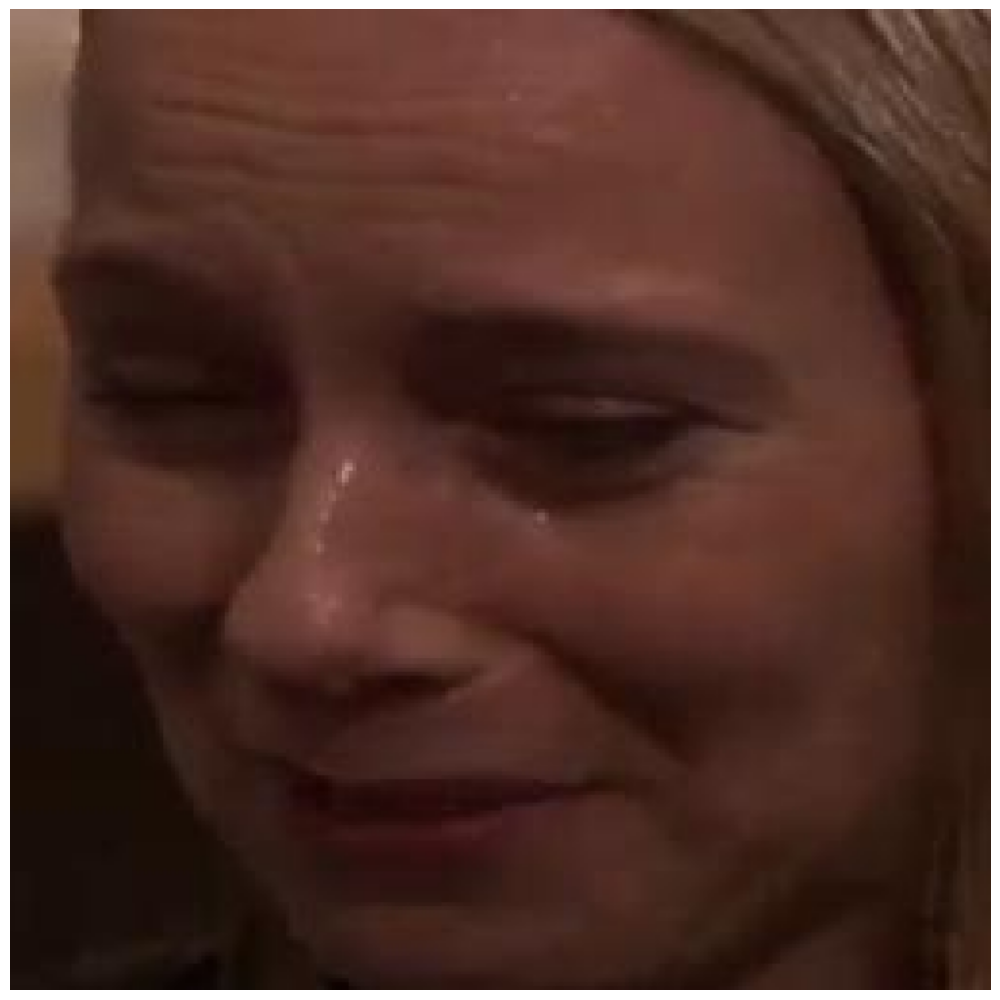

Medoid for cluster 2


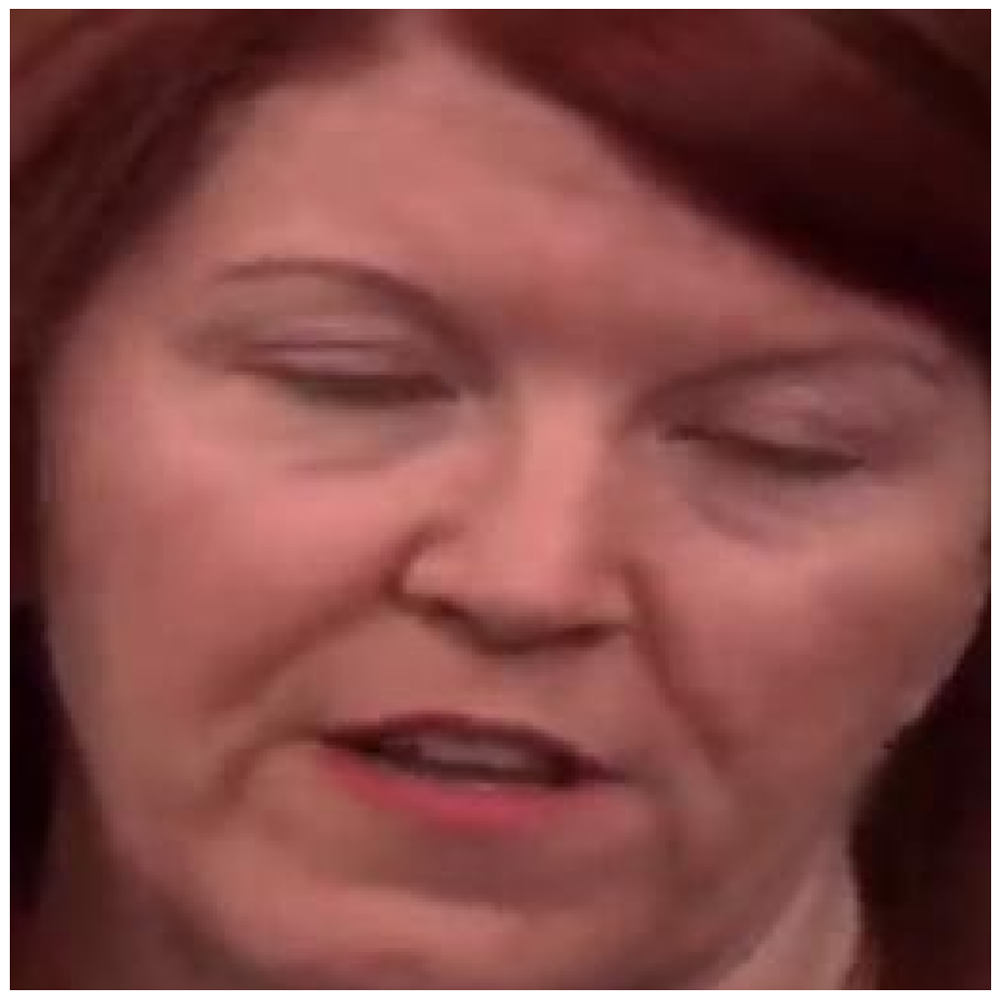

Medoid for cluster 3


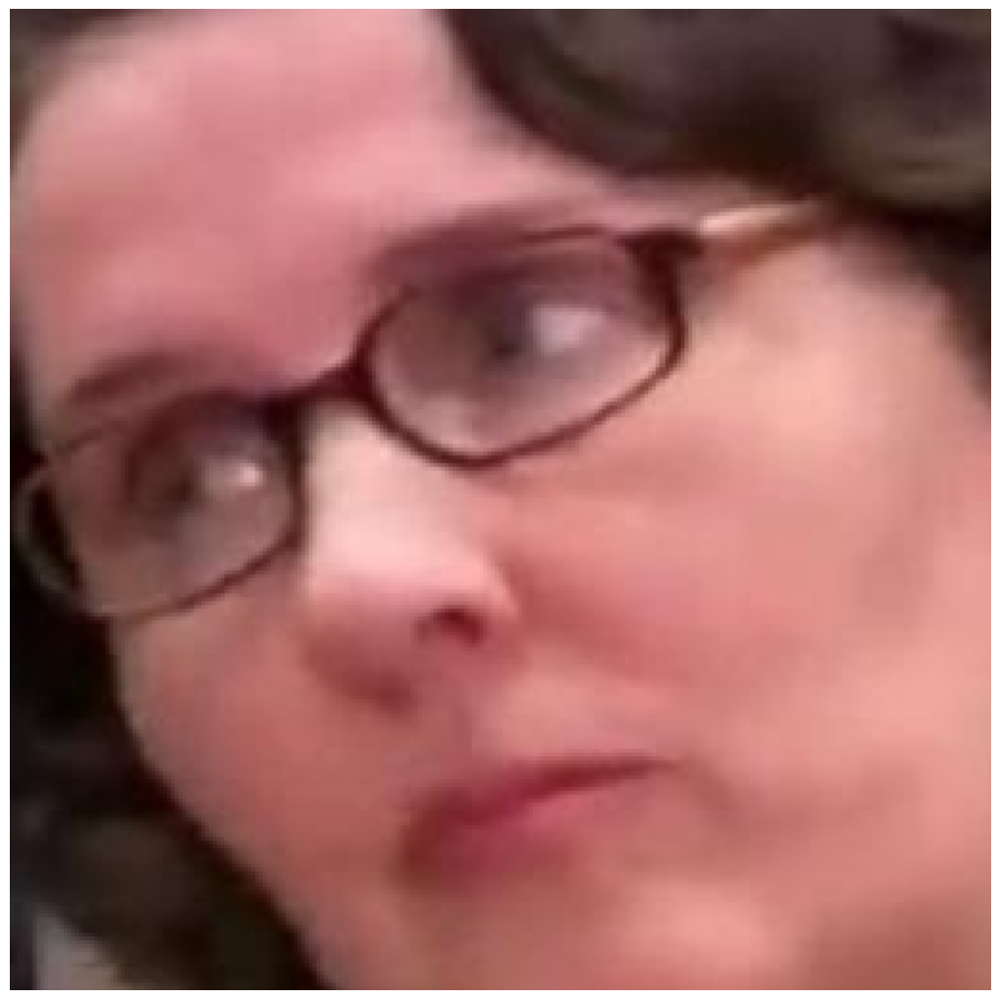

Medoid for cluster 4


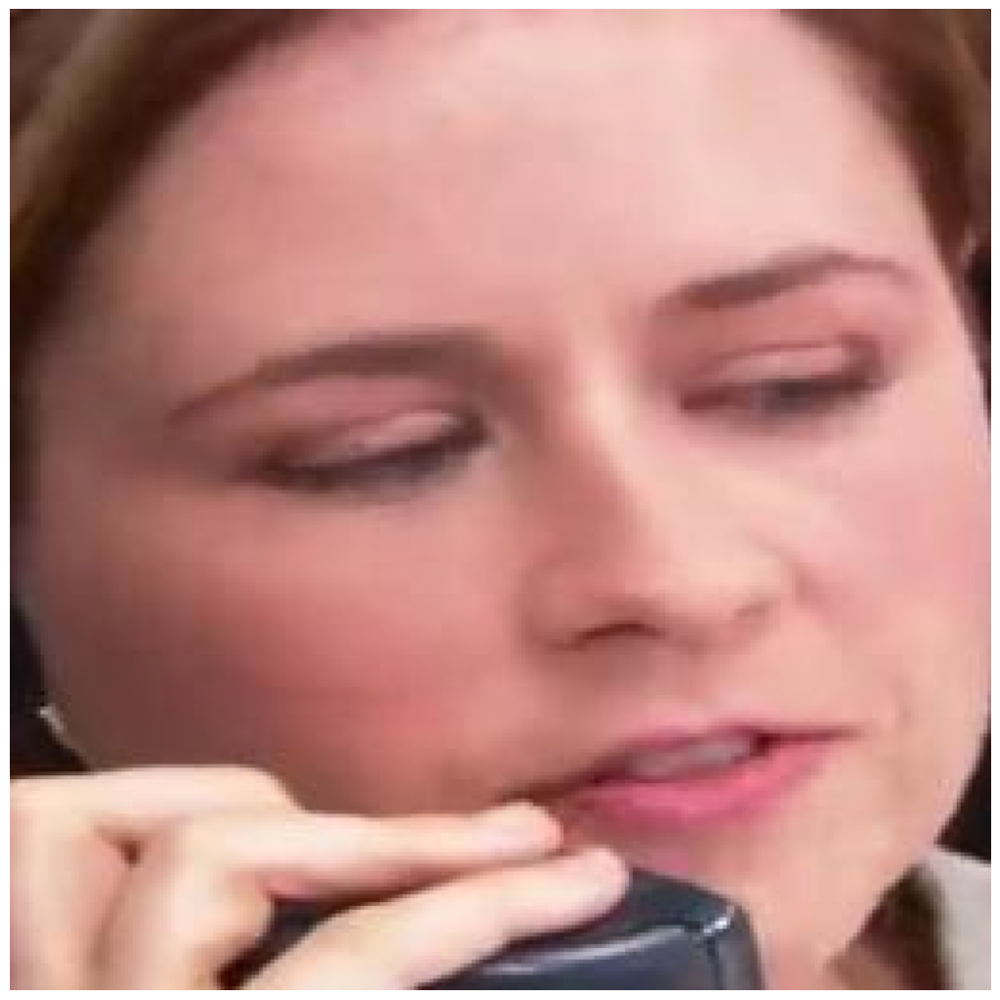

Medoid for cluster 5


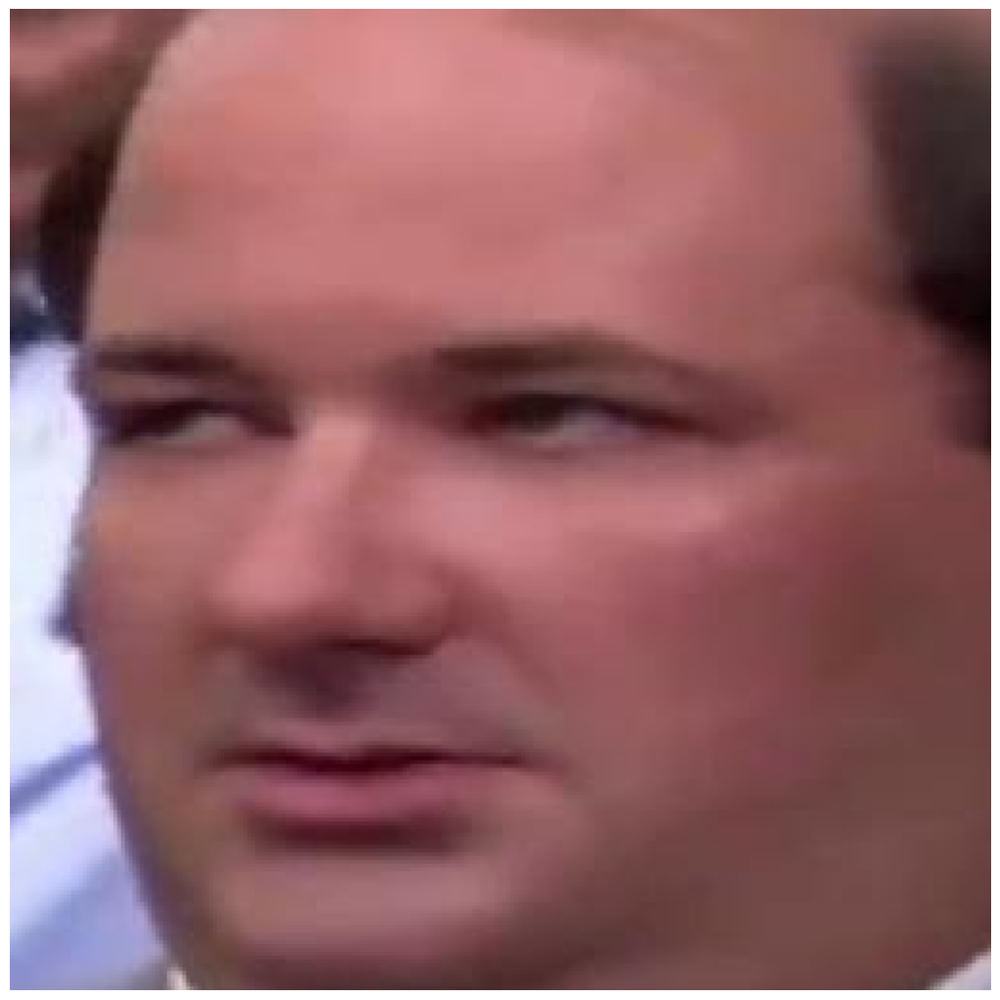

Medoid for cluster 6


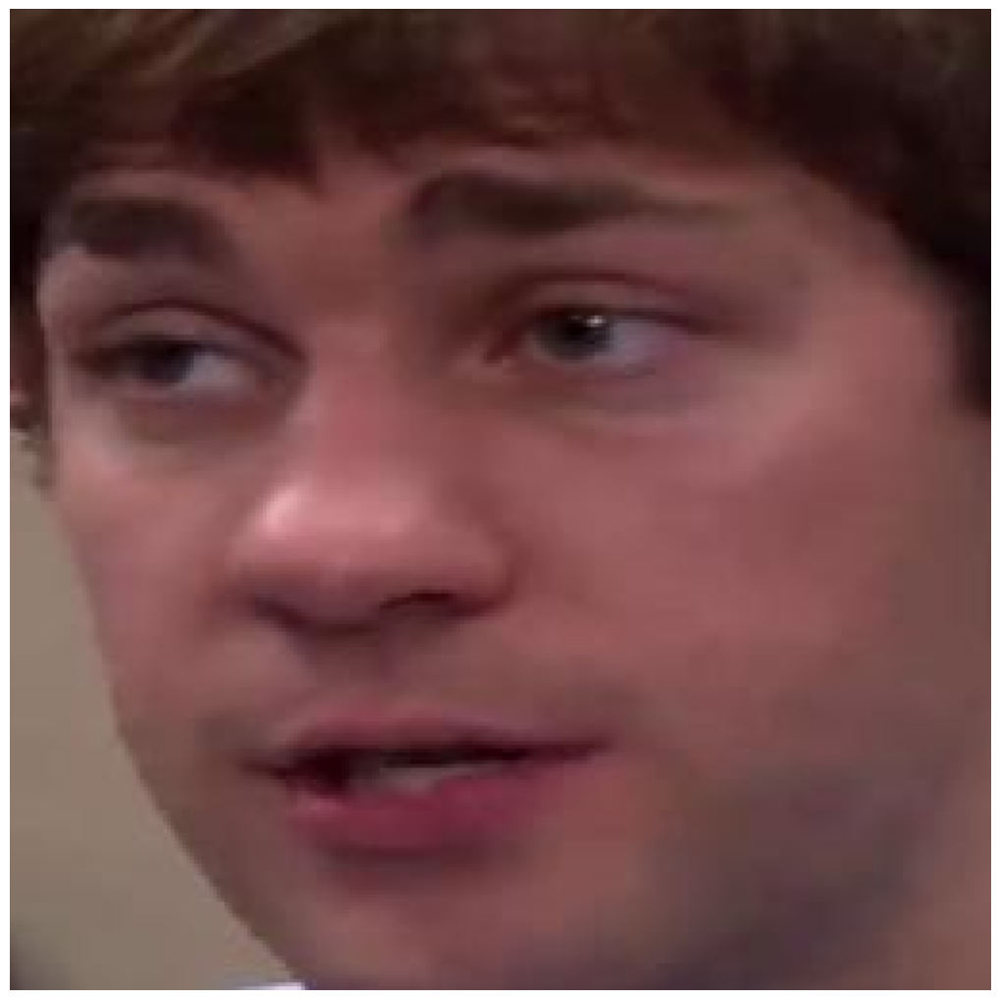

Medoid for cluster 7


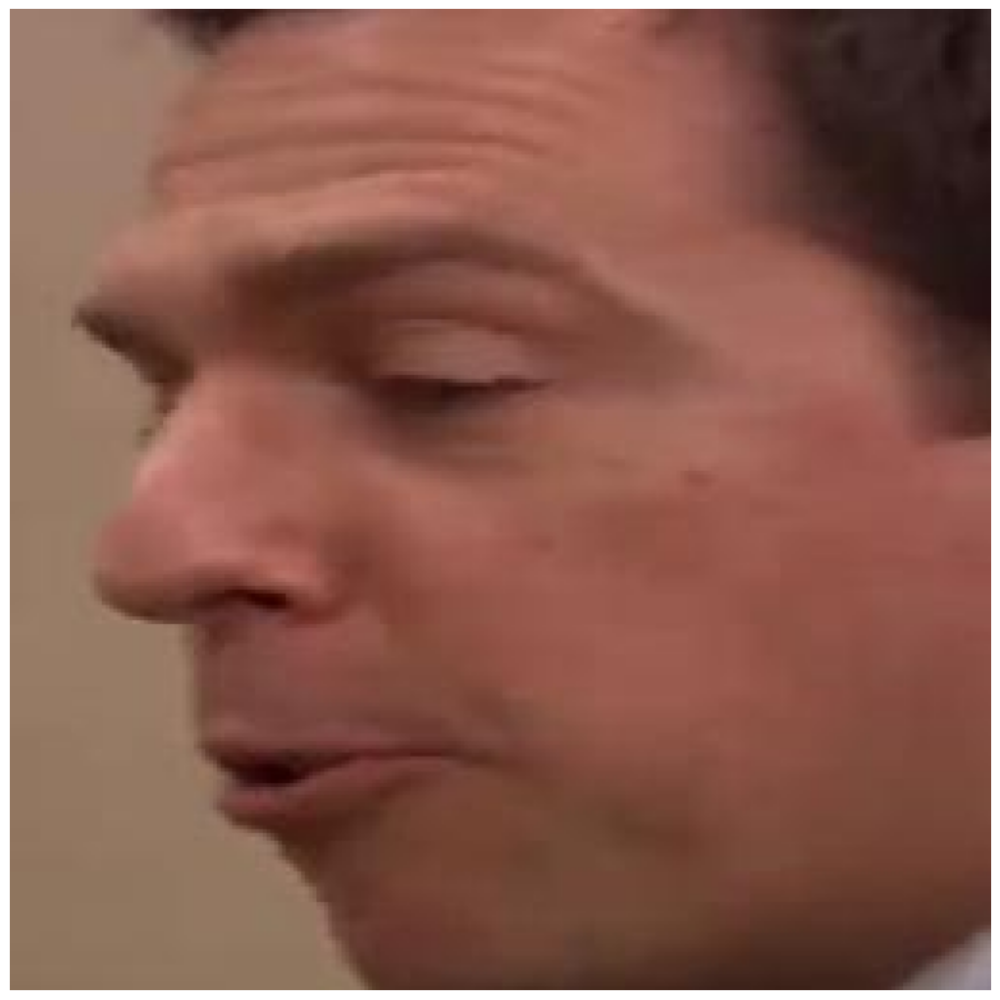

Medoid for cluster 8


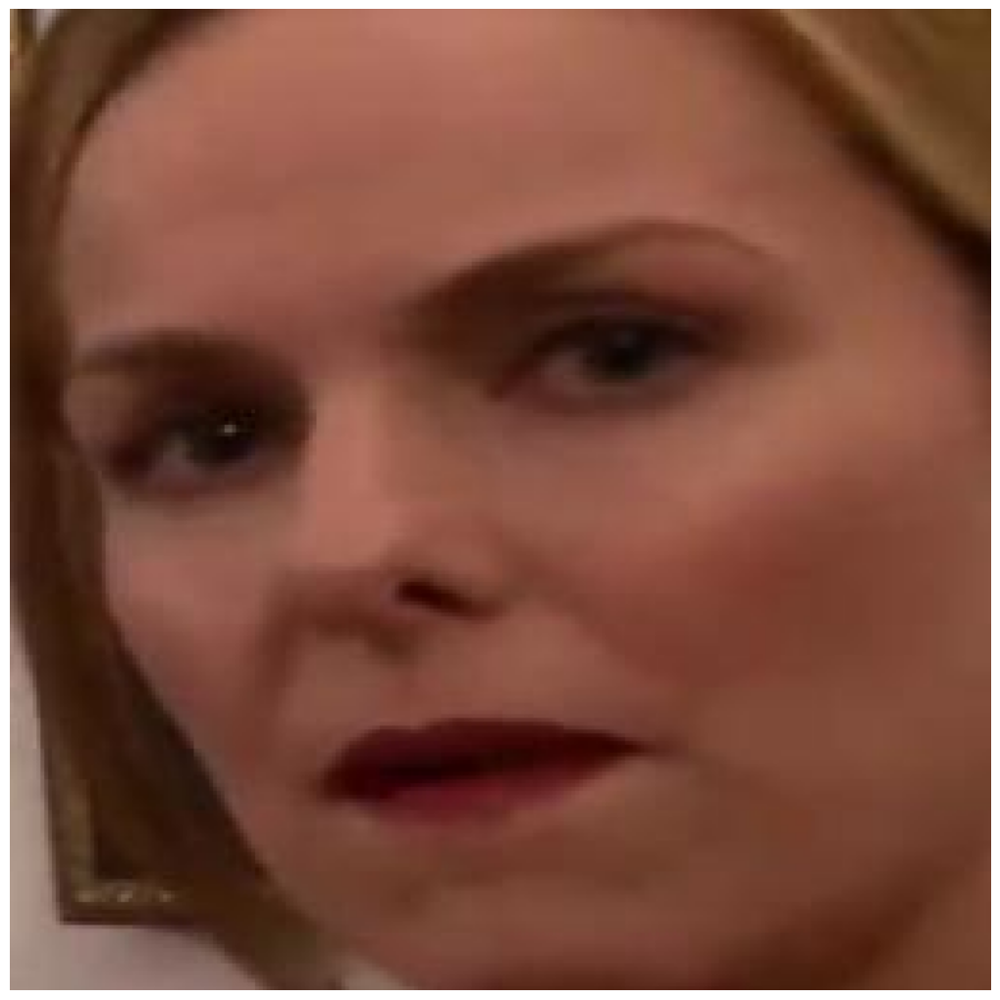

Medoid for cluster 9


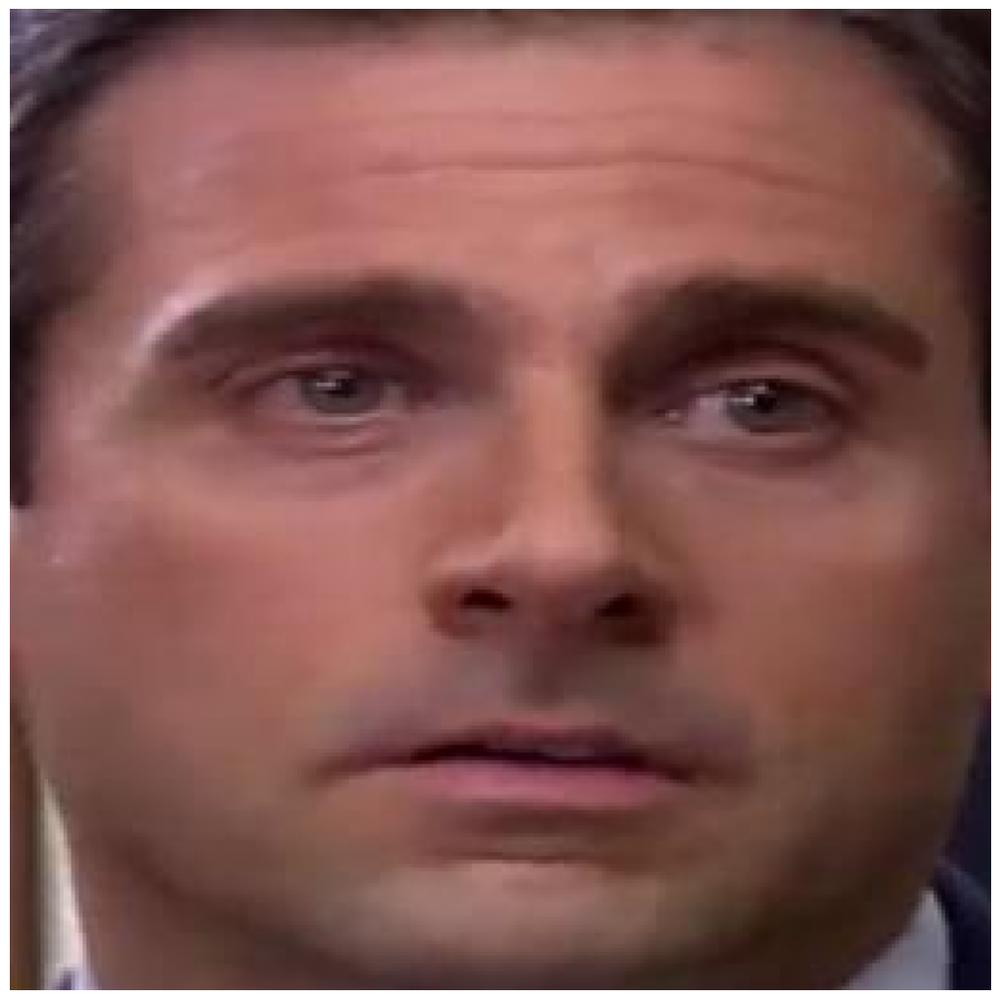

Medoid for cluster 10


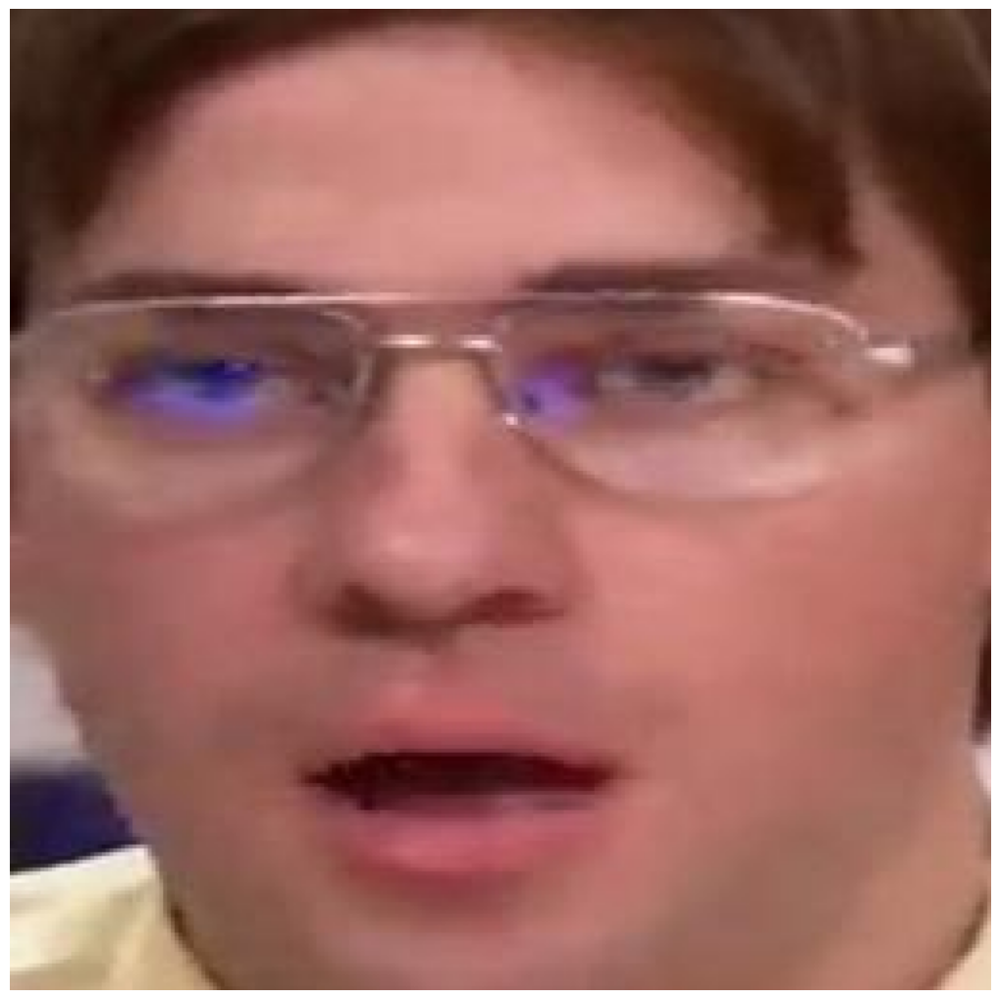

Medoid for cluster 11


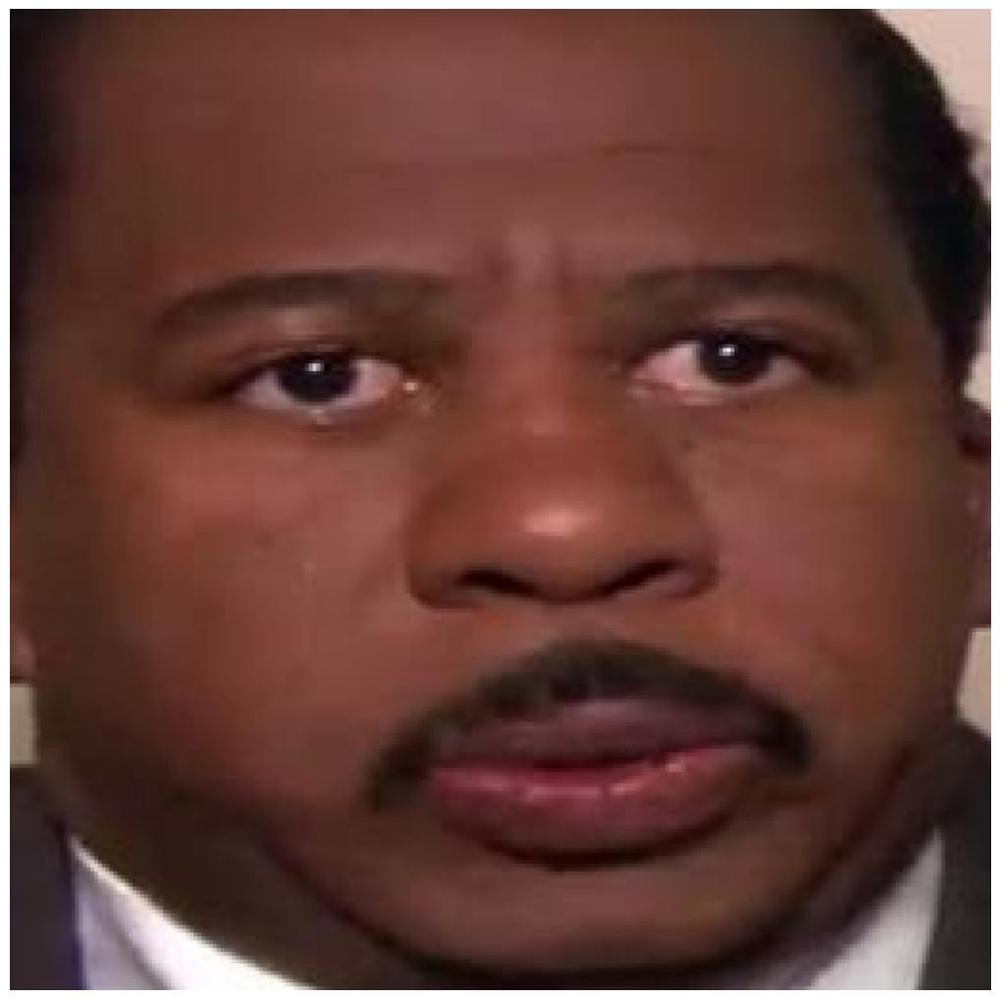

Medoid for cluster 12


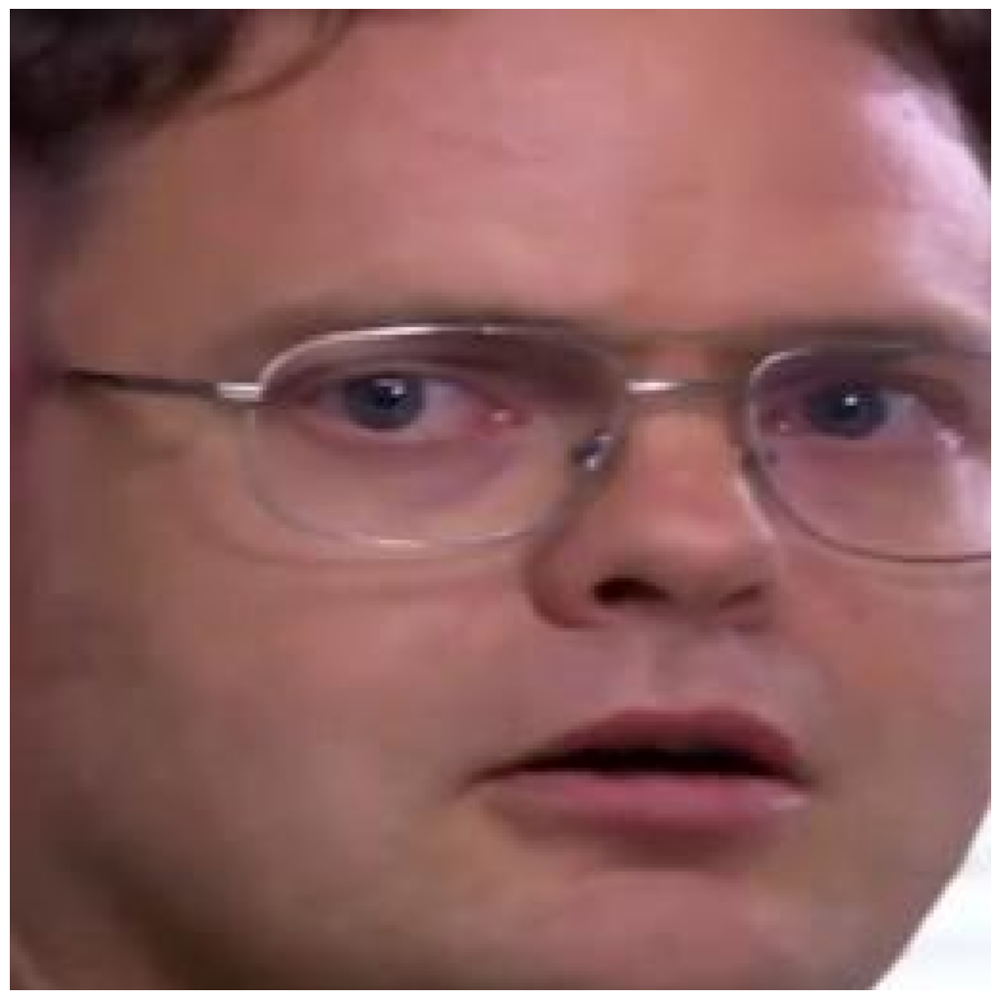

Medoid for cluster 13


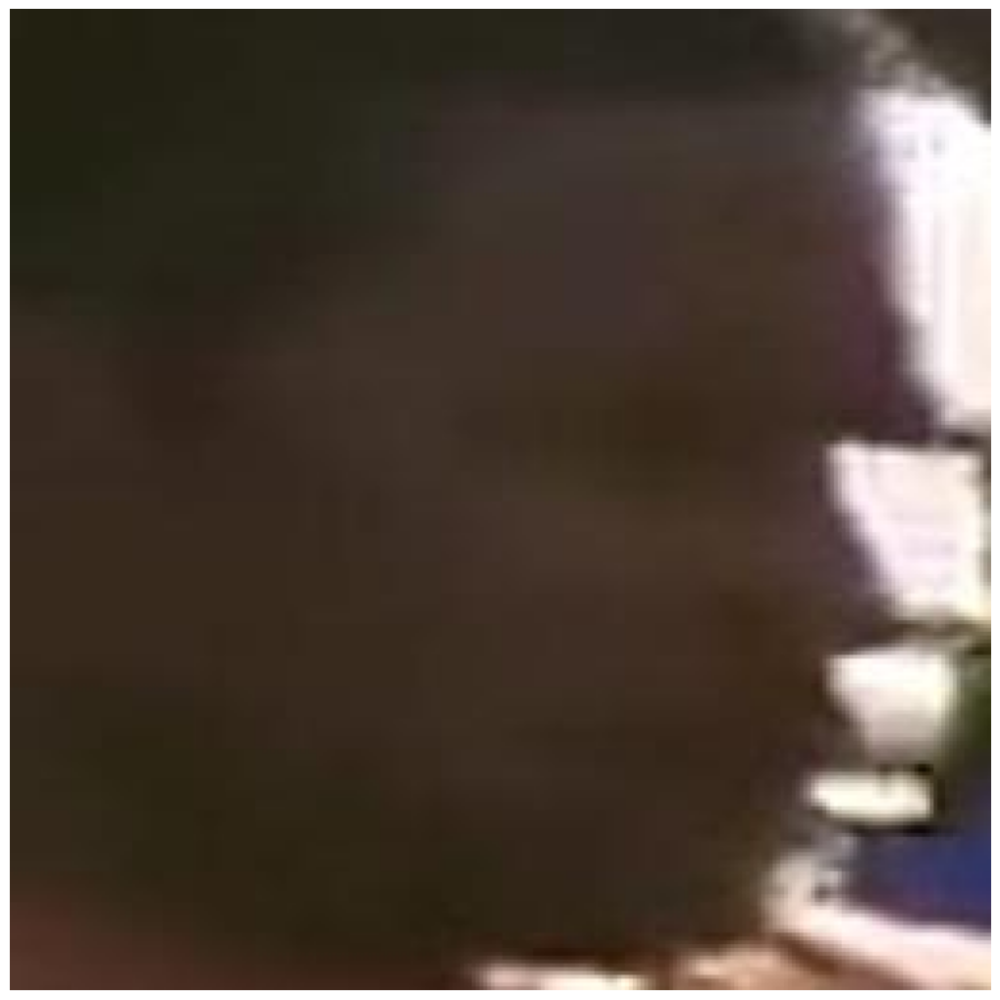

In [29]:
clstr.find_medoid_image()

- The medoid of cluster 13 gives us clue why this cluster is erraneous.
- We will save the medoids and cluster Ids to use in the service

In [42]:
import pickle
with open("cluster_mediods.pkl","wb") as f:
    pickle.dump(clstr.mediods,f)

In [44]:
cluster_ids = np.delete(clstr.cluster_ids,0)
with open("cluster_ids.pkl","wb") as f:
    pickle.dump(cluster_ids,f)

## Visualization

From the above pipeline, above we want to learn more about the video and people included in them, like, how many frames have multiple people, in how many frames does person X appear, who has the most screen time, the least screen time.

Use above pipeline results to create visualizations that explore the contents of the video.

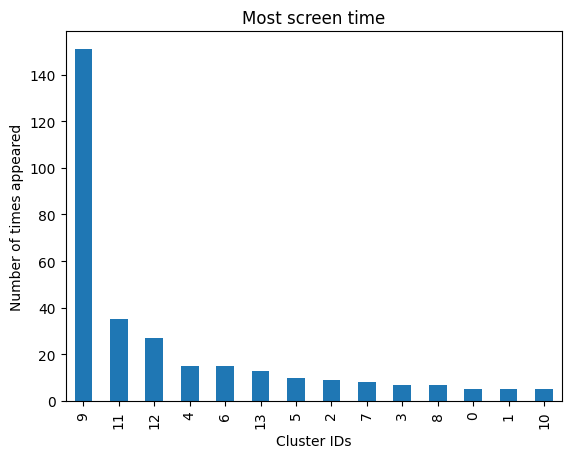

In [32]:
import matplotlib.pyplot as plt

cluster_stats = clstr.cluster_stats
cluster_stats.drop(-1,inplace=True)
cluster_stats.plot.bar()

plt.title("Most screen time")
plt.xlabel("Cluster IDs")
plt.ylabel("Number of times appeared")
plt.show()

In [33]:
frame_details = [(frame_path,num_faces) for frame_path , num_faces in face_extractor.frame_stats.items()]
faces_stats_df = pd.DataFrame(frame_details,columns=["frame_path","num_faces"])


In [34]:
# Total number of frames
faces_stats_df.shape[0]

683

In [35]:
# Average number of faces in a frame
faces_stats_df["num_faces"].mean()

1.9062957540263543

In [36]:
# Maximum number of faces in a frame
faces_stats_df["num_faces"].max()

10

In [37]:
# Number of frames with more than 1 face
faces_stats_df[faces_stats_df.num_faces >1].shape[0]

293

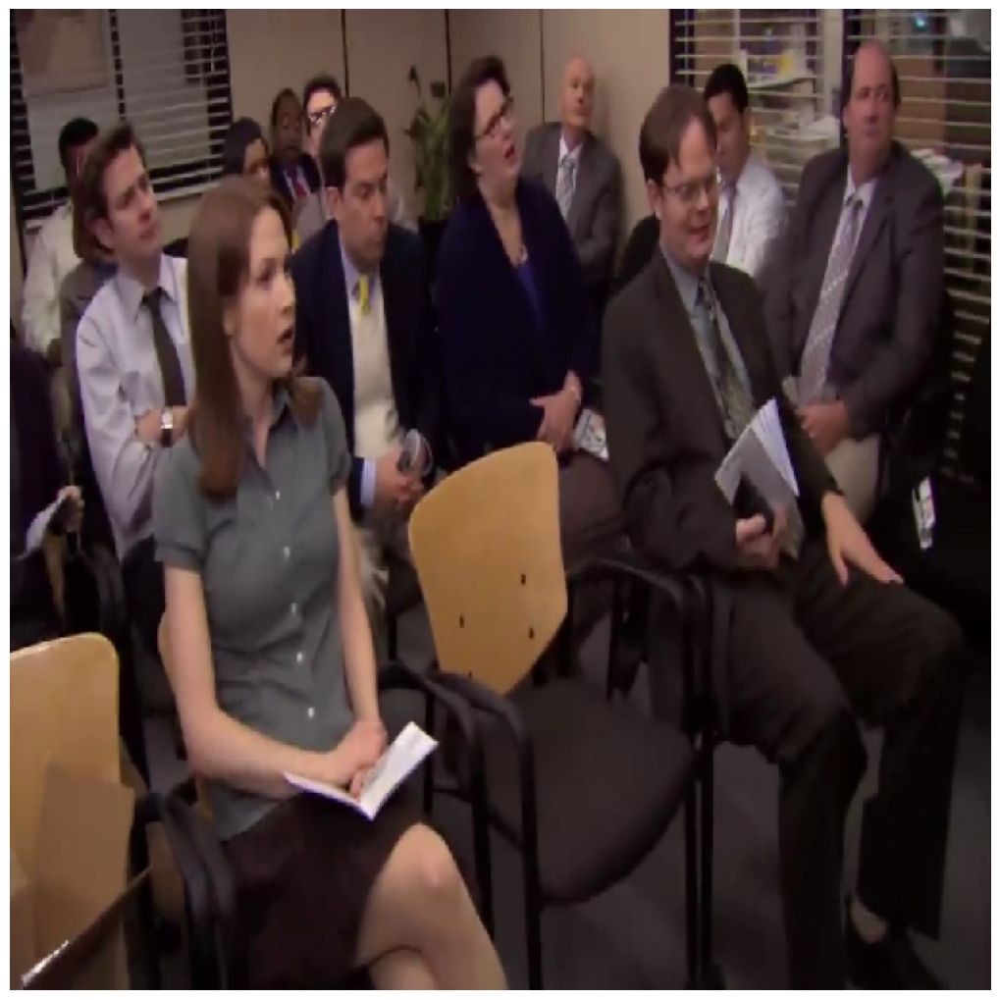

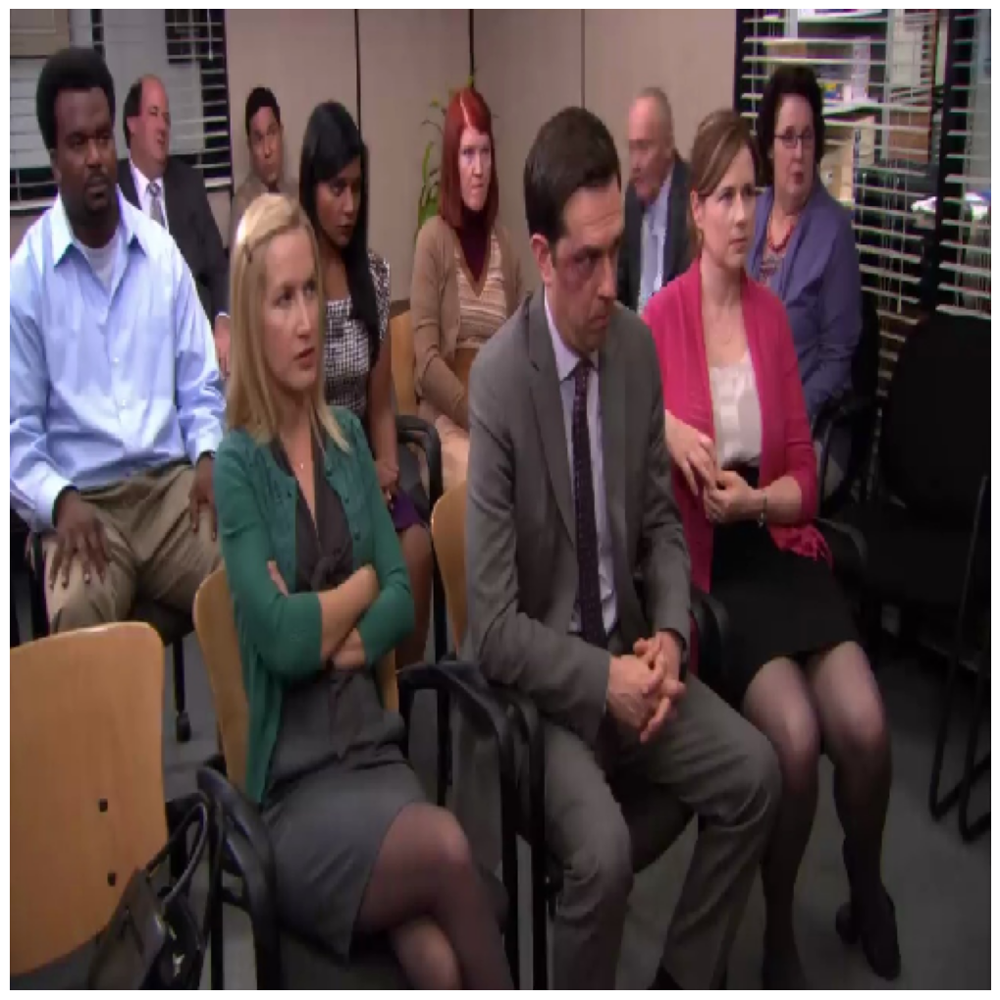

In [38]:
# Frames which are having maximum number of faces
for frame_path in faces_stats_df[faces_stats_df.num_faces == 10]["frame_path"].unique().tolist():
    DocumentArray.from_files(frame_path).plot_image_sprites()

In [40]:
faces_stats_df[faces_stats_df.num_faces == 10]["frame_path"].unique().tolist()

['/Users/whiletruelearn/projects/video-analytics/frames/frame_4370.jpg',
 '/Users/whiletruelearn/projects/video-analytics/frames/frame_8556.jpg']

## Deployment

In [3]:
# feel free to write code here or create extra .py scripts and Dockerfile for deployment.
# include instructions on how to setup the dockerfile, create a docker image and run it
# include instructions on how to send a Request to this dockerize solution.

In [ ]:
!docker build -t fastapi-service .

In [ ]:
!docker run -p 8000:8000 fastapi-service

Go to `localhost:8000/docs`

#### API Request

In [ ]:
!curl -X 'POST' \
  'http://localhost:8000/get_people_from_image' \
  -H 'accept: application/json' \
  -H 'Content-Type: multipart/form-data' \
  -F 'image_file=@frame_529.jpg;type=image/jpeg'

```json
{
  "result": [
    {
      "image_path": "/tmp/tmpe9h7kl3q/temp_image.jpg",
      "left": 545,
      "top": 217,
      "right": 834,
      "bottom": 584,
      "cluster_id": 9
    },
    {
      "image_path": "/tmp/tmpe9h7kl3q/temp_image.jpg",
      "left": 302,
      "top": 219,
      "right": 451,
      "bottom": 412,
      "cluster_id": 6
    }
  ]
}
```